<a href="https://colab.research.google.com/github/Dinarque/INALCO_Inalco_M2_langage_de_scripts_2024_eleves/blob/main/TP/TP1_de_Flaubert_a_FlauBERT_eleves.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **TP1 : De Flaubert à FlauBERT**


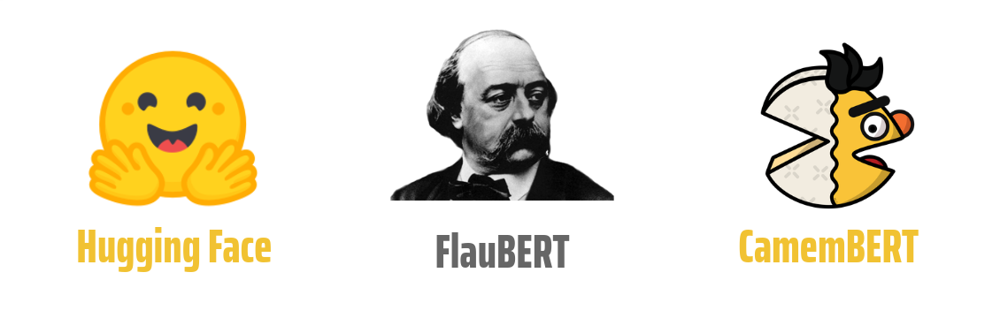

Quelques révisions du programme de première année, et au delà !

**Objectifs : **

1) Réviser les fondamentaux de l'écriture de scripts en python (structures de données et bonnes pratiques), et notamment:
* le téléchargement et l'ouverture de fichiers
* les fonctions essentielles de nettoyage du texte
* le stockage des informations pertinentes dans des structures de données adaptées

2) Savoir comment utiliser python pour répondre à des questions pratiques sur des données. Savoir réfléchir à la manière de découper une question abstraite (Ex: quel est le vocabulaire particulier de Flaubert par rapport aux autres romanciers du 19ième siècle ?) en une liste d'instructions que vous pouvez coder pour obtenir la réponse

3) Etudier (informatiquement) le style de Flaubert, car c'est un des meilleurs auteurs qui soient

# 1) préliminaires pour accéder à l'Education Sentimentale

Pour commencer par le commencement, il faut charger les textes de Flaubert.

* Pour ne pas poluer l'onglet du notebook, créez (en codant !!) un répertoire nommé "romans_Flaubert" dans le notebook

In [38]:
!mkdir romans_Flaubert

* Faites la même chose en python en utilisant la librairie os

In [39]:
import os

In [40]:
os.mkdir("./romans_Flaubert") 

FileExistsError: [Errno 17] File exists: './romans_Flaubert'

* Téléchargez-y en utilisant la librairie urllib le texte de l'Education Sentimentale puis en utilisant la librairie os, saubegardez le roman dans le dossier que vous avez créé

In [41]:


import urllib.request
import os

# Étape 1 : Télécharger le texte de L'Éducation sentimentale
url = "https://www.gutenberg.org/cache/epub/49773/pg49773.txt"  # URL de L'Éducation sentimentale sur Gutenberg
response = urllib.request.urlopen(url)
texte_education_sentimentale = response.read().decode('utf-8')  # Lire et décoder le texte

# Étape 2 : Créer le dossier "romans_Flaubert" s'il n'existe pas
dossier = "romans_Flaubert"
if not os.path.exists(dossier):
    os.makedirs(dossier)

# Étape 3 : Sauvegarder le texte dans un fichier dans ce dossier
chemin_fichier = os.path.join(dossier, "Education_Sentimentale.txt")
with open(chemin_fichier, "w", encoding="utf-8") as f:
    f.write(texte_education_sentimentale)

print(f"Le texte a été sauvegardé dans : {chemin_fichier}")


Le texte a été sauvegardé dans : romans_Flaubert/Education_Sentimentale.txt


* Transformez votre série d'instructions en fonction (qui prend en entrée le nom d'un roman) et téléchargez tous le corpus (on téléchargera les autres textes après)

In [42]:
import urllib.request
import os

def telecharger_roman(nom_du_roman, url):
    """
    Télécharge un roman à partir d'une URL et le sauvegarde dans le dossier 'romans_Flaubert'.
    
    Paramètres :
    - nom_du_roman : Le nom du roman à sauvegarder (string, sans extension).
    - url : L'URL du roman (string).
    """
    
    # Étape 1 : Télécharger le texte depuis l'URL
    try:
        response = urllib.request.urlopen(url)
        texte = response.read().decode('utf-8')
    except Exception as e:
        print(f"Erreur lors du téléchargement du roman {nom_du_roman}: {e}")
        return

    # Étape 2 : Créer le dossier 'romans_Flaubert' s'il n'existe pas
    dossier = "romans_Flaubert"
    if not os.path.exists(dossier):
        os.makedirs(dossier)

    # Étape 3 : Sauvegarder le texte dans un fichier dans ce dossier
    chemin_fichier = os.path.join(dossier, f"{nom_du_roman}.txt")
    try:
        with open(chemin_fichier, "w", encoding="utf-8") as f:
            f.write(texte)
        print(f"Le roman '{nom_du_roman}' a été sauvegardé dans : {chemin_fichier}")
    except Exception as e:
        print(f"Erreur lors de la sauvegarde du roman {nom_du_roman}: {e}")

# Exemple d'utilisation pour télécharger L'Éducation sentimentale
telecharger_roman("Education_Sentimentale", "https://www.gutenberg.org/cache/epub/49773/pg49773.txt")


Le roman 'Education_Sentimentale' a été sauvegardé dans : romans_Flaubert/Education_Sentimentale.txt


* écrire une fonction  qui prend en entrée le nom d'un roman et renvoie le texte du roman stocké dans le fichier. La tester sur l'ES et afficher les 500 premières lignes

In [2]:
def lire_roman_lignes(nom_du_roman, nb_lignes=500):
    """
    Lit un roman ligne par ligne à partir d'un fichier et affiche les premières lignes.
    
    Paramètre :
    - nom_du_roman : Le nom du fichier du roman (string, sans extension).
    - nb_lignes : Le nombre de lignes à afficher (par défaut 500).
    """
    chemin_fichier = f"romans_Flaubert/{nom_du_roman}.txt"
    try:
        with open(chemin_fichier, "r", encoding="utf-8") as f:
            # Lire et afficher les 500 premières lignes
            for i, ligne in enumerate(f, start=1):
                print(f"{i}: {ligne.strip()}")  # strip() enlève les espaces inutiles
                if i >= nb_lignes:
                    break
    except FileNotFoundError:
        print(f"Le fichier '{chemin_fichier}' n'existe pas.")
    except Exception as e:
        print(f"Erreur lors de la lecture du fichier '{chemin_fichier}': {e}")

# Tester la fonction sur L'Éducation sentimentale
nom_du_roman = "Education_Sentimentale"
lire_roman_lignes(nom_du_roman)


1: The Project Gutenberg eBook of OEuvres completes de Gustave Flaubert, tome 3: L'education sentimentale, v. 1
2: 
3: This ebook is for the use of anyone anywhere in the United States and
4: most other parts of the world at no cost and with almost no restrictions
5: whatsoever. You may copy it, give it away or re-use it under the terms
6: of the Project Gutenberg License included with this ebook or online
7: at www.gutenberg.org. If you are not located in the United States,
8: you will have to check the laws of the country where you are located
9: before using this eBook.
10: 
11: Title: OEuvres completes de Gustave Flaubert, tome 3: L'education sentimentale, v. 1
12: 
13: Author: Gustave Flaubert
14: 
15: Release date: August 24, 2015 [eBook #49773]
16: 
17: Language: French
18: 
19: Credits: Produced by Claudine Corbasson and the Online Distributed
20: Proofreading Team at http://www.pgdp.net (This file was
21: produced from images generously made available by The
22: Internet Archi

# 2) Nettoyer l'oeuvre du maître


Le texte que nous avons téléchargé n'est pas de la meilleure qualité. Comme vous le voyez on tombe sur un passage en anglais...  Réglons cela !



* Vérifiez que le texte était bien en encodage UTF-8 (vous pouvez utiliser la librairie chardet)

In [44]:
!pip install chardet

In [45]:
import chardet

# Vérifier l'encodage du fichier en une seule instruction
encoding = chardet.detect(open("romans_Flaubert/Education_Sentimentale.txt", 'rb').read(10000))['encoding']

print(encoding)


UTF-8-SIG


* Enlevez tous les caractères spéciaux (ne conserver que les caractères latins). Quelle librairie pourrait le faire le plus facilement ?



In [46]:
!pip install unidecode

In [47]:
from unidecode import unidecode

def remove_special_characters_from_file(file_path):
    # Lire le texte du fichier
    with open(file_path, 'r', encoding='utf-8') as f:
        text = f.read()
    
    # Normaliser et enlever les caractères spéciaux
    cleaned_text = unidecode(text)  # Normalisation
    
    # Afficher le texte nettoyé
    print(cleaned_text)

    # Réécrire le texte nettoyé dans le même fichier
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(cleaned_text)

# Chemin vers le fichier de l'éducation sentimentale
file_path = "romans_Flaubert/Education_Sentimentale.txt"  # Remplacez par le chemin vers votre fichier

# Appeler la fonction
remove_special_characters_from_file(file_path)

print("Caractères spéciaux enlevés et texte sauvegardé dans", file_path)


The Project Gutenberg eBook of OEuvres completes de Gustave Flaubert, tome 3: L'education sentimentale, v. 1
    
This ebook is for the use of anyone anywhere in the United States and
most other parts of the world at no cost and with almost no restrictions
whatsoever. You may copy it, give it away or re-use it under the terms
of the Project Gutenberg License included with this ebook or online
at www.gutenberg.org. If you are not located in the United States,
you will have to check the laws of the country where you are located
before using this eBook.

Title: OEuvres completes de Gustave Flaubert, tome 3: L'education sentimentale, v. 1

Author: Gustave Flaubert

Release date: August 24, 2015 [eBook #49773]

Language: French

Credits: Produced by Claudine Corbasson and the Online Distributed
        Proofreading Team at http://www.pgdp.net (This file was
        produced from images generously made available by The
        Internet Archive/Canadian Libraries)


*** START OF THE PROJECT G

* Enlevez tous les contenus textuels qui ne sont pas l'oeuvre de Flaubert (vous pouvez garder les préfaces, que vous encoderez le cas échéant avec la clé "preface" dans la question suivante).
Indice : ils sont en anglais !

In [48]:
import os

def extraire_contenu_flaubert(fichier):
    """
    Fonction qui extrait la préface, l'œuvre et la postface à partir d'un fichier texte.
    """
    with open(fichier, 'r', encoding='utf-8') as f:
        contenu = f.read()

    # Balises de début et de fin d'œuvre
    debut_oeuvre = "*** START OF THE PROJECT GUTENBERG EBOOK"
    fin_oeuvre = "*** END OF THE PROJECT GUTENBERG EBOOK"
    
    preface, oeuvre, postface = "", "", ""
    
    if debut_oeuvre in contenu and fin_oeuvre in contenu:
        print(f"Traitement du fichier : {fichier}")  # Affichage pour voir que le fichier est bien traité
        preface = contenu.split(debut_oeuvre)[0].strip()
        post_oeuvre_contenu = contenu.split(debut_oeuvre)[1]
        oeuvre = post_oeuvre_contenu.split(fin_oeuvre)[0].strip()
        postface = post_oeuvre_contenu.split(fin_oeuvre)[1].strip()
        print(f"Contenu extrait : {len(preface)} caractères de préface, {len(oeuvre)} caractères d'œuvre, {len(postface)} caractères de postface.")
    else:
        print(f"Balises non trouvées dans {fichier}. Contenu ignoré.")
    
    return {"preface": preface, "oeuvre": oeuvre, "postface": postface}

def sauvegarder_texte(fichier_sortie, oeuvre):
    """
    Sauvegarde uniquement le contenu de l'œuvre dans un fichier texte.
    """
    with open(fichier_sortie, 'w', encoding='utf-8') as f:
        # Sauvegarder uniquement l'œuvre
        f.write(oeuvre + "\n")  # Ici, oeuvre est bien une chaîne de caractères

def traiter_dossier(dossier, dossier_sortie):
    """
    Traite tous les fichiers .txt dans un dossier et ses sous-dossiers et sauvegarde uniquement les œuvres dans un autre dossier.
    """
    # Créer le dossier de sortie s'il n'existe pas
    if not os.path.exists(dossier_sortie):
        os.makedirs(dossier_sortie)

    # Compteur pour vérifier combien de fichiers sont traités
    total_fichiers = 0

    # Parcourir récursivement le dossier
    for dirpath, _, filenames in os.walk(dossier):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                # Extraire le contenu pour chaque fichier
                contenu = extraire_contenu_flaubert(chemin_fichier)
                
                # Vérifier s'il y a bien du contenu à sauvegarder
                if contenu["oeuvre"]:
                    # Créer un chemin de sortie pour le fichier filtré
                    fichier_sortie = os.path.join(dossier_sortie, nom_fichier)
                    
                    # Sauvegarder uniquement le texte de l'œuvre dans le nouveau fichier
                    sauvegarder_texte(fichier_sortie, contenu["oeuvre"])  # Assurez-vous de passer seulement l'œuvre
                    print(f"Fichier sauvegardé : {fichier_sortie}")
                    total_fichiers += 1
                else:
                    print(f"Aucun contenu à sauvegarder pour {chemin_fichier}")

    print(f"{total_fichiers} fichiers ont été traités et sauvegardés.")

# Exemple d'utilisation
dossier_a_traiter = './romans_Flaubert'  # Remplacez par le chemin du dossier contenant les œuvres
dossier_sortie = './romans_Flaubert_filtre'  # Dossier de sortie pour sauvegarder uniquement les œuvres filtrées

traiter_dossier(dossier_a_traiter, dossier_sortie)

print(f"Les fichiers filtrés ont été sauvegardés dans {dossier_sortie}.")


Traitement du fichier : ./romans_Flaubert/Education_Sentimentale.txt
Contenu extrait : 971 caractères de préface, 415024 caractères d'œuvre, 18675 caractères de postface.
Fichier sauvegardé : ./romans_Flaubert_filtre/Education_Sentimentale.txt
1 fichiers ont été traités et sauvegardés.
Les fichiers filtrés ont été sauvegardés dans ./romans_Flaubert_filtre.


# 3) Organiser l'oeuvre

L'objectif de cette partie sera de stocker de manière efficace toute l'oeuvre de Flaubert dans la variable "oeuvre_Flaubert" : un dictionnaire de dictionnaires ayant comme clé le titre du livre (sans accent) et en valeur un dictionnaire ayant comme clé le numéro de chapitre (un chiffre romain) et retournant le texte de ce chapitre.

Remarquez que chaque chapitre est noté par un chiffre romain et est précédé et suivi de deux sauts de ligne.


* écrivez une fonction prenant en entrée le texte d'un roman et effectuant un split sur les séquences du type deux sauts de ligne, une ligne avec du texte, deux sauts de ligne, et qui renvoie un dictionnaire associant la chaîne de caractère contenue entre les sauts de ligne et lui associe le texte avant la prochaine séparation


In [49]:
import re

def split_text_sections(text):
    # Expression régulière pour trouver des sections de texte séparées par deux sauts de ligne avant et après un titre
    pattern = r'\n\n(.*?)\n\n'
    
    # On utilise re.split pour diviser le texte en segments en fonction des sections identifiées
    parts = re.split(pattern, text)
    
    # Initialiser un dictionnaire pour stocker les sections
    sections = {}
    
    # Le premier élément de 'parts' est le texte avant le premier titre, donc on le saute.
    # Les éléments suivants sont sous la forme [titre, texte, titre, texte...]
    for i in range(1, len(parts), 2):
        section_title = parts[i].strip()  # Le texte trouvé entre les sauts de ligne
        section_text = parts[i + 1].strip()  # Le texte avant le prochain titre ou la fin
        sections[section_title] = section_text
    
    return sections

# Exemple d'utilisation avec un texte
roman_text = """
\n\nChapitre I\n\nCeci est le texte du premier chapitre.\n\nChapitre II\n\nCeci est le texte du deuxième chapitre.\n\nChapitre III\n\nCeci est le texte du troisième chapitre.\n\n"""

# Appeler la fonction avec le texte
result = split_text_sections(roman_text)

# Afficher le dictionnaire retourné
print(result)


{'Chapitre I': 'Ceci est le texte du premier chapitre.', 'Chapitre II': 'Ceci est le texte du deuxième chapitre.', 'Chapitre III': 'Ceci est le texte du troisième chapitre.'}


* à votre avis, faut-il mieux utiliser la fonction qui enlève l'anglais avant de procéder au découpage par chapitre ou après sur chaque chapire ? Pourquoi ? Essayez les deux et commentez les résultats

Il serait préférable d'enlever les parties en anglais avant de procéder au découpage par chapitre. Voici pourquoi :

    Cohérence des chapitres : Si on effectue d'abord le découpage en chapitres, certaines sections de texte en anglais pourraient être intégrées dans les chapitres, ce qui compliquerait la tâche d'identifier clairement les chapitres appartenant à l'œuvre de Flaubert. En enlevant d'abord le contenu en anglais, on a une meilleure garantie que chaque chapitre découpé correspond au texte de Flaubert.

    Fiabilité du découpage : Les sections en anglais, comme les préfaces ou autres commentaires, peuvent inclure des formats ou des structures de texte différentes (comme des sous-titres ou des sauts de ligne inhabituels), qui pourraient perturber l'algorithme de découpage en chapitres. En nettoyant le texte avant, on évite de découper incorrectement à cause de ces variations.

    Performance : Le traitement du texte complet avant de le diviser est généralement plus efficace, car on évite d'avoir à parcourir chaque chapitre individuellement pour ensuite filtrer le contenu. On effectue le filtrage une seule fois sur l'ensemble du texte, puis on divise proprement en chapitres.

* Pour le dictionnaire des idées reçues, puisque c'est déjà un  dictionnaire dans la forme, stockez-le dans un dictionnaire qui associe à chaque mot sa  définition

Repérez que les mots définis sont en lettres capitales.
Regardez comment se structure le texte et écrivez une fonction pour traiter le dictionnaire spécifiquement

In [50]:
# Télécharger le dictionnaire des idées reçues
telecharger_roman("Dico_idees_recues", "https://www.gutenberg.org/cache/epub/14156/pg14156.txt")

Le roman 'Dico_idees_recues' a été sauvegardé dans : romans_Flaubert/Dico_idees_recues.txt


In [51]:
import re

def parse_dico(text):
    # Expression régulière pour trouver les mots en majuscules et leurs définitions
    pattern = r'([A-ZÉÈÊÀÛÄÏÇ]+):?\s(.*?)(?=\n[A-ZÉÈÊÀÛÄÏÇ]+:|\n\n|$)'
    
    # Trouver toutes les correspondances dans le texte
    matches = re.findall(pattern, text, re.DOTALL)
    
    # Initialiser le dictionnaire pour stocker les résultats
    dico = {}
    
    # Parcourir les correspondances et remplir le dictionnaire
    for match in matches:
        word = match[0].strip()  # Mot en majuscules
        definition = match[1].strip().replace('\n', ' ')  # Définition associée, nettoyée des sauts de ligne
        dico[word] = definition
    
    return dico

# Charger le contenu du fichier
with open("./romans_Flaubert/Dico_idees_recues.txt", encoding='utf-8') as f:
    dico_text = f.read()

# Appeler la fonction pour parser le dictionnaire
dico_idees_recues = parse_dico(dico_text)

# Afficher quelques exemples pour vérifier
for word, definition in list(dico_idees_recues.items())[:10]:
    print(f"{word}: {definition}\n")


START: FULL LICENSE

DICTIONNAIRE: En dire: «N'est fait que pour les ignorants.» Dictionnaire de rimes: s'en servir? Honteux!

A: 

ABELARD: Inutile d'avoir la moindre idée de sa philosophie, ni même de connaître le titre de ses ouvrages. Faire une allusion discrète à la mutilation opérée sur lui par Fulbert. Tombeau d'Eloïse et d'Abélard: si l'on vous prouve qu'il est faux, s'écrier: «Vous m'ôtez mes illusions. «

ABRICOTS: Nous n'en aurons pas encore cette année.

ABSALON: S'il eût porté perruque, Joab n'aurait pu le tuer. Nom facétieux à donner à un ami chauve.

ABSINTHE: Poison extra-violent: un verre et vous êtes mort. Les journalistes en boivent pendant qu'ils écrivent leurs articles. A tué plus de soldats que les Bédouins.

ACADÉMIE: FRANCAISE: La dénigrer, mais tâcher d'en faire partie si on peut.

ACCIDENT: Toujours déplorable ou fâcheux (comme si on devait jamais trouver un malheur une chose réjouissante...).

ACCOUCHEMENT: Mot à éviter; le remplacer par événement. «Pour quel

* écrivez un code qui traite tout le corpus

In [52]:
import urllib.request
import os

def telecharger_texte(url):
    """Télécharge le texte à partir de l'URL donnée et le retourne sous forme de chaîne."""
    response = urllib.request.urlopen(url)
    texte = response.read().decode('utf-8')  # Lire et décoder le texte
    return texte

def creer_dossier(nom_dossier):
    """Crée un dossier avec le nom donné s'il n'existe pas."""
    if not os.path.exists(nom_dossier):
        os.makedirs(nom_dossier)

def sauvegarder_texte(texte, chemin_fichier):
    """Sauvegarde le texte dans un fichier spécifié."""
    with open(chemin_fichier, "w", encoding="utf-8") as f:
        f.write(texte)

def creation_corpus(url, nom_dossier, nom_fichier):
    texte = telecharger_texte(url)

    creer_dossier(nom_dossier)

    chemin_fichier = os.path.join(nom_dossier, nom_fichier)
    sauvegarder_texte(texte, chemin_fichier)

    print(f"Le texte a été sauvegardé dans : {chemin_fichier}")



creation_corpus("https://www.gutenberg.org/cache/epub/14155/pg14155.txt", "romans_Flaubert", "Madame_Bovary.txt")
creation_corpus("https://www.gutenberg.org/cache/epub/14157/pg14157.txt", "romans_Flaubert", "Bouvard_et_Pecuchet.txt")
creation_corpus("https://www.gutenberg.org/cache/epub/48881/pg48881.txt", "romans_Flaubert", "Salammbô.txt")
creation_corpus("https://www.gutenberg.org/cache/epub/12065/pg12065.txt", "romans_Flaubert", "Trois_Contes.txt")
creation_corpus("https://www.gutenberg.org/cache/epub/26812/pg26812.txt", "romans_Flaubert", "Un_Coeur_simple.txt")

Le texte a été sauvegardé dans : romans_Flaubert/Madame_Bovary.txt
Le texte a été sauvegardé dans : romans_Flaubert/Bouvard_et_Pecuchet.txt
Le texte a été sauvegardé dans : romans_Flaubert/Salammbô.txt
Le texte a été sauvegardé dans : romans_Flaubert/Trois_Contes.txt
Le texte a été sauvegardé dans : romans_Flaubert/Un_Coeur_simple.txt


In [53]:
import os

def extraire_contenu_flaubert(fichier):
    """
    Fonction qui extrait la préface, l'œuvre et la postface à partir d'un fichier texte.
    """
    with open(fichier, 'r', encoding='utf-8') as f:
        contenu = f.read()

    # Balises de début et de fin d'œuvre
    debut_oeuvre = "*** START OF THE PROJECT GUTENBERG EBOOK"
    fin_oeuvre = "*** END OF THE PROJECT GUTENBERG EBOOK"
    
    preface, oeuvre, postface = "", "", ""
    
    if debut_oeuvre in contenu and fin_oeuvre in contenu:
        print(f"Traitement du fichier : {fichier}")  # Affichage pour voir que le fichier est bien traité
        preface = contenu.split(debut_oeuvre)[0].strip()
        post_oeuvre_contenu = contenu.split(debut_oeuvre)[1]
        oeuvre = post_oeuvre_contenu.split(fin_oeuvre)[0].strip()
        postface = post_oeuvre_contenu.split(fin_oeuvre)[1].strip()
        print(f"Contenu extrait : {len(preface)} caractères de préface, {len(oeuvre)} caractères d'œuvre, {len(postface)} caractères de postface.")
    else:
        print(f"Balises non trouvées dans {fichier}. Contenu ignoré.")
    
    return {"preface": preface, "oeuvre": oeuvre, "postface": postface}

def sauvegarder_texte(fichier_sortie, oeuvre):
    """
    Sauvegarde uniquement le contenu de l'œuvre dans un fichier texte.
    """
    with open(fichier_sortie, 'w', encoding='utf-8') as f:
        # Sauvegarder uniquement l'œuvre
        f.write(oeuvre + "\n")  # Ici, oeuvre est bien une chaîne de caractères

def traiter_dossier(dossier, dossier_sortie):
    """
    Traite tous les fichiers .txt dans un dossier et ses sous-dossiers et sauvegarde uniquement les œuvres dans un autre dossier.
    """
    # Créer le dossier de sortie s'il n'existe pas
    if not os.path.exists(dossier_sortie):
        os.makedirs(dossier_sortie)

    # Compteur pour vérifier combien de fichiers sont traités
    total_fichiers = 0

    # Parcourir récursivement le dossier
    for dirpath, _, filenames in os.walk(dossier):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                # Extraire le contenu pour chaque fichier
                contenu = extraire_contenu_flaubert(chemin_fichier)
                
                # Vérifier s'il y a bien du contenu à sauvegarder
                if contenu["oeuvre"]:
                    # Créer un chemin de sortie pour le fichier filtré
                    fichier_sortie = os.path.join(dossier_sortie, nom_fichier)
                    
                    # Sauvegarder uniquement le texte de l'œuvre dans le nouveau fichier
                    sauvegarder_texte(fichier_sortie, contenu["oeuvre"])  # Assurez-vous de passer seulement l'œuvre
                    print(f"Fichier sauvegardé : {fichier_sortie}")
                    total_fichiers += 1
                else:
                    print(f"Aucun contenu à sauvegarder pour {chemin_fichier}")

    print(f"{total_fichiers} fichiers ont été traités et sauvegardés.")

# Exemple d'utilisation
dossier_a_traiter = './romans_Flaubert'  # Remplacez par le chemin du dossier contenant les œuvres
dossier_sortie = './romans_Flaubert_filtre'  # Dossier de sortie pour sauvegarder uniquement les œuvres filtrées

traiter_dossier(dossier_a_traiter, dossier_sortie)

print(f"Les fichiers filtrés ont été sauvegardés dans {dossier_sortie}.")


Traitement du fichier : ./romans_Flaubert/Education_Sentimentale.txt
Contenu extrait : 971 caractères de préface, 415024 caractères d'œuvre, 18675 caractères de postface.
Fichier sauvegardé : ./romans_Flaubert_filtre/Education_Sentimentale.txt
Traitement du fichier : ./romans_Flaubert/Un_Coeur_simple.txt
Contenu extrait : 701 caractères de préface, 68731 caractères d'œuvre, 18440 caractères de postface.
Fichier sauvegardé : ./romans_Flaubert_filtre/Un_Coeur_simple.txt
Traitement du fichier : ./romans_Flaubert/Dico_idees_recues.txt
Contenu extrait : 777 caractères de préface, 74899 caractères d'œuvre, 18454 caractères de postface.
Fichier sauvegardé : ./romans_Flaubert_filtre/Dico_idees_recues.txt
Traitement du fichier : ./romans_Flaubert/Trois_Contes.txt
Contenu extrait : 921 caractères de préface, 184974 caractères d'œuvre, 18437 caractères de postface.
Fichier sauvegardé : ./romans_Flaubert_filtre/Trois_Contes.txt
Traitement du fichier : ./romans_Flaubert/Salammbô.txt
Contenu extrait

In [2]:
import os
import re
from unidecode import unidecode
from langdetect import detect

# Fonction pour charger les fichiers du corpus
def load_text(nom_dossier, fichiers):
    corpus = {}
    
    for nom_fichier in fichiers:
        chemin_fichier = os.path.join(nom_dossier, nom_fichier)
        
        # Ouvrir et lire le contenu du fichier
        with open(chemin_fichier, 'r', encoding='utf-8') as f:
            texte = f.read()
            titre = os.path.splitext(nom_fichier)[0].replace('_', ' ')
            corpus[titre] = texte
    
    return corpus

# Fonction pour détecter et séparer les parties en anglais
def remove_english_content(text):
    sentences = re.split(r'(?<=[.!?]) +', text)  # Split en phrases
    filtered_text = []
    preface = []

    for sentence in sentences:
        try:
            lang = detect(sentence)  # Détecter la langue de chaque phrase
            if lang == 'fr':
                filtered_text.append(sentence)  # Garder les phrases en français
            elif lang == 'en':
                preface.append(sentence)  # Mettre les phrases en anglais dans la préface
        except:
            continue
    
    return ' '.join(filtered_text), ' '.join(preface)

# Fonction pour découper le texte en parties et chapitres
def split_chapters_and_parts(text):
    """
    Gère les chapitres et les parties :
    - CHAPITRE I, CHAPITRE II, etc.
    - I, II, III, etc.
    - PREMIÈRE PARTIE, DEUXIÈME PARTIE, etc.
    """
    # Expression régulière pour détecter les parties
    partie_pattern = r'(PREMIERE PARTIE|DEUXIEME PARTIE|TROISIEME PARTIE)\n+'
    
    # Expression régulière pour détecter les chapitres (avec ou sans "CHAPITRE")
    chapitre_pattern = r'(CHAPITRE\s+[IVXLCDM]+|[IVXLCDM]+)\n+'

    # Diviser le texte en parties
    parts = re.split(partie_pattern, text)

    chapters = {}
    current_part = None
    
    for i in range(len(parts)):
        if i % 2 == 1:  # Partie détectée
            current_part = parts[i].strip()
        else:  # Contenu de la partie ou du texte principal
            part_text = parts[i].strip()
            
            # Diviser la partie en chapitres
            chapter_parts = re.split(chapitre_pattern, part_text)
            
            for j in range(1, len(chapter_parts), 2):
                chapitre = chapter_parts[j].strip()
                texte_chapitre = chapter_parts[j + 1].strip()

                # Utiliser la partie si elle existe, sinon juste le numéro du chapitre
                if current_part:
                    chapter_key = f"{current_part} - {chapitre}"
                else:
                    chapter_key = f"{chapitre}"
                
                chapters[chapter_key] = texte_chapitre
    
    return chapters

# Fonction pour nettoyer les caractères spéciaux
def remove_special_characters_from_file(file_path):
    with open(file_path, 'r', encoding='utf-8') as f:
        text = f.read()
    
    cleaned_text = unidecode(text)  # Utiliser unidecode pour enlever les caractères spéciaux
    
    with open(file_path, 'w', encoding='utf-8') as f:
        f.write(cleaned_text)

# Fonction de traitement du corpus
def traiter_corpus(nom_dossier, fichiers):
    corpus = load_text(nom_dossier, fichiers)
    
    oeuvre_Flaubert = {}
    
    for titre, texte in corpus.items():
        # Nettoyage des caractères spéciaux
        filtered_text, preface = remove_english_content(texte)
        
        # Diviser le texte en chapitres et parties
        chapters = split_chapters_and_parts(filtered_text)
        
        if preface:
            chapters['preface'] = preface
        
        oeuvre_Flaubert[titre] = chapters
    
    return oeuvre_Flaubert




# Liste des fichiers correspondant aux textes de Flaubert
fichiers = [
    "Madame_Bovary.txt",
    "Education_Sentimentale.txt",
    "Bouvard_et_Pecuchet.txt",
    "Salammbô.txt",
    "Trois_Contes.txt",
    "Un_Coeur_simple.txt"
]

# Nettoyer les fichiers avant traitement
for fichier in fichiers:
    remove_special_characters_from_file(f"romans_Flaubert_filtre/{fichier}")

    
    
    
    
# Enlever les caractères spéciaux
remove_special_characters_from_file("romans_Flaubert_filtre/Bouvard_et_Pecuchet.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Dico_idees_recues.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Education_Sentimentale.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Madame_Bovary.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Salammbô.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Trois_Contes.txt")
remove_special_characters_from_file("romans_Flaubert_filtre/Un_Coeur_simple.txt")
    
    
# Nom du dossier contenant les fichiers
nom_dossier = "./romans_Flaubert_filtre"



# Appeler la fonction pour traiter tout le corpus
oeuvre_Flaubert = traiter_corpus(nom_dossier, fichiers)

# Afficher un exemple de sortie (par exemple les premiers chapitres de Madame Bovary)
print("Madame Bovary :", list(oeuvre_Flaubert["Madame Bovary"].items())[:5])


Madame Bovary : [('PREMIERE PARTIE - I', "Nous etions a l'Etude, quand le Proviseur entra, suivi d'un\nnouveau habille en bourgeois et d'un garcon de classe qui portait\nun grand pupitre. Ceux qui dormaient se reveillerent, et chacun se\nleva comme surpris dans son travail.\n\nLe Proviseur nous fit signe de nous rasseoir; puis, se tournant\nvers le maitre d'etudes:\n\n-- Monsieur Roger, lui dit-il a demi-voix, voici un eleve que je\nvous recommande, il entre en cinquieme. Si son travail et sa\nconduite sont meritoires, il passera dans les grands, ou l'appelle\nson age.\n\nReste dans l'angle, derriere la porte, si bien qu'on l'apercevait\na peine, le nouveau etait un gars de la campagne, d'une quinzaine\nd'annees environ, et plus haut de taille qu'aucun de nous tous. Il\navait les cheveux coupes droit sur le front, comme un chantre de\nvillage, l'air raisonnable et fort embarrasse. Quoiqu'il ne fut\npas large des epaules, son habit-veste de drap vert a boutons\nnoirs devait le gener aux

In [56]:
import re

def parse_dictionnaire(text):
    # Expression régulière pour capturer les mots en majuscules suivis de leur définition
    pattern = r'([A-ZÉÈÊÀÛÄÏÇ ]+):?\s(.*?)(?=\n[A-ZÉÈÊÀÛÄÏÇ ]+:\s|\n\n|$)'
    
    # Trouver toutes les correspondances dans le texte
    matches = re.findall(pattern, text, re.DOTALL)
    
    # Initialiser le dictionnaire pour stocker les résultats
    dico = {}
    
    # Parcourir les correspondances et remplir le dictionnaire
    for match in matches:
        word = match[0].strip()  # Mot en majuscules
        definition = match[1].strip().replace('\n', ' ')  # Définition associée, nettoyage des sauts de ligne
        dico[word] = definition
    
    return dico

# Charger le texte du Dictionnaire des idées reçues (extrait du fichier)
with open('./romans_Flaubert/Dico_idees_recues.txt', encoding='utf-8') as f:
    dico_text = f.read()

# Appeler la fonction pour parser le Dictionnaire
dico_idees_recues = parse_dictionnaire(dico_text)


# Afficher les clés du dictionnaire (les termes définis)
print(dico_idees_recues.keys())

# Afficher un extrait (par exemple, la définition de 'ABSINTHE')
print(f"ABSINTHE: {dico_idees_recues.get('ABSINTHE', 'Non trouvé')}")


dict_keys(['', 'START OF THE PROJECT GUTENBERG EBOOK DICTIONNAIRE DES IDEES RECUES', 'DICTIONNAIRE DES IDEES RECUES', 'A', 'ABELARD', 'ABRICOTS', 'ABSALON', 'ABSINTHE', 'ACADEMIE FRANCAISE', 'ACCIDENT', 'ACCOUCHEMENT', 'ACHILLE', 'ACTRICES', 'ADIEUX', 'ADOLESCENT', 'AFFAIRES', 'AGENT', 'AGRICULTURE', 'AIL', 'AIR', 'AIRAIN', 'ALBATRE', 'ALBION', 'ALCIBIADE', 'ALCOOLISME', 'ALLEMAGNE', 'ALLEMANDS', 'AMBITIEUX', 'AMBITION', 'AMERIQUE', 'AMIRAL', 'ANDROCLES', 'ANGE', 'ANGLAIS', 'ANGLAISES', 'ANTECHRIST', 'ANTIQUITE', 'ANTIQUITES', 'APLOMB', 'APPARTEMENT', 'ARBALETE', 'ARCHIMEDE', 'ARCHITECTES', 'ARCHITECTURE', 'ARGENT', 'ARMEE', 'ARSENIC', 'ART', 'ARTISTES', 'ASPIC', 'ASSASSIN', 'ASTRONOMIE', 'ATHEE', 'AUTEUR', 'AUTRUCHE', 'AVOCATS', 'B', 'BACCALAUREAT', 'BADAUD', 'BADIGEON', 'BAGNOLET', 'BAGUE', 'BAILLEMENT', 'BAISER', 'BALLONS', 'BANDITS', 'BANQUET', 'BANQUIERS', 'BARAGOUIN', 'BARBE', 'BARBIER', 'BLEU', 'BASES', 'BASILIQUE', 'BASQUES', 'BATAILLE', 'BATON', 'BAUDRUCHE', 'BAYADERE', 'BEETH

In [57]:
oeuvre_Flaubert['Dico idees recues'] = dico_idees_recues

* Pour vérifier que tout fonctionne bien, cherchez:
- la liste des textes stockés
- le chapitre 9 de Madame Bovary
- le texte d'un Coeur Simple
- la définition du mot "introduction" dans le Dictionnaire des idées reçues.

In [58]:
# La liste des textes stockés
oeuvre_Flaubert.keys()

dict_keys(['Madame Bovary', 'Education Sentimentale', 'Bouvard et Pecuchet', 'Salammbô', 'Trois Contes', 'Un Coeur simple', 'Dico idees recues'])

In [60]:
# Le chapitre 9 de Madame Bovary
oeuvre_Flaubert["Madame Bovary"]["PREMIERE PARTIE - IX"]

"Souvent, lorsque Charles etait sorti, elle allait prendre dans\nl'armoire, entre les plis du linge ou elle l'avait laisse, le\nporte-cigares en soie verte.\n\nElle le regardait, l'ouvrait, et meme elle flairait l'odeur de sa\ndoublure, melee de verveine et de tabac. A qui appartenait-il?...\nAu Vicomte. C'etait peut-etre un cadeau de sa maitresse. On avait\nbrode cela sur quelque metier de palissandre, meuble mignon que\nl'on cachait a tous les yeux, qui avait occupe bien des heures et\nou s'etaient penchees les boucles molles de la travailleuse\npensive. Un souffle d'amour avait passe parmi les mailles du\ncanevas; chaque coup d'aiguille avait fixe la une esperance ou un\nsouvenir, et tous ces fils de soie entrelaces n'etaient que la\ncontinuite de la meme passion silencieuse. Et puis le Vicomte, un\nmatin, l'avait emporte avec lui. De quoi avait-on parle, lorsqu'il\nrestait sur les cheminees a large chambranle, entre les vases de\nfleurs et les pendules Pompadour? Elle etait a Toste

In [61]:
# Le texte d'Un Coeur Simple
" ".join(oeuvre_Flaubert["Un Coeur simple"].values())

'(...)\n\n\nUN COEUR SIMPLE Pendant un demi-siecle, les bourgeoises de Pont l\'Eveque\nenvierent a Mme Aubain sa servante Felicite.\n\nPour cent francs par an, elle faisait la cuisine et le menage,\ncousait, lavait, repassait, savait brider un cheval,\nengraisser les volailles, battre le beurre, et resta fidele a\nsa maitresse, -- qui cependant n\'etait pas une personne\nagreable.\n\nElle avait epouse un beau garcon sans fortune, mort au\ncommencement de 1809, en lui laissant deux enfants tres jeunes\navec une quantite de dettes. Alors elle vendit ses immeubles,\nsauf la ferme de Toucques et la ferme de Geffosses, dont les\nrentes montaient a 5, 000 francs tout au plus, et elle quitta\nsa maison de Saint-Melaine pour en habiter une autre moins\ndispendieuse, ayant appartenu a ses ancetres et placee\nderriere les halles.\n\nCette maison, revetue d\'ardoises, se trouvait entre un passage\net une ruelle aboutissant a la riviere. Elle avait\ninterieurement des differences de niveau qui fai

In [62]:
oeuvre_Flaubert["Un Coeur simple"]

{'MDCCCCX': '(...)\n\n\nUN COEUR SIMPLE',
 'I': 'Pendant un demi-siecle, les bourgeoises de Pont l\'Eveque\nenvierent a Mme Aubain sa servante Felicite.\n\nPour cent francs par an, elle faisait la cuisine et le menage,\ncousait, lavait, repassait, savait brider un cheval,\nengraisser les volailles, battre le beurre, et resta fidele a\nsa maitresse, -- qui cependant n\'etait pas une personne\nagreable.\n\nElle avait epouse un beau garcon sans fortune, mort au\ncommencement de 1809, en lui laissant deux enfants tres jeunes\navec une quantite de dettes. Alors elle vendit ses immeubles,\nsauf la ferme de Toucques et la ferme de Geffosses, dont les\nrentes montaient a 5, 000 francs tout au plus, et elle quitta\nsa maison de Saint-Melaine pour en habiter une autre moins\ndispendieuse, ayant appartenu a ses ancetres et placee\nderriere les halles.\n\nCette maison, revetue d\'ardoises, se trouvait entre un passage\net une ruelle aboutissant a la riviere. Elle avait\ninterieurement des differen

In [68]:
oeuvre_Flaubert["Madame Bovary"]

{'PREMIERE PARTIE - I': "Nous etions a l'Etude, quand le Proviseur entra, suivi d'un\nnouveau habille en bourgeois et d'un garcon de classe qui portait\nun grand pupitre. Ceux qui dormaient se reveillerent, et chacun se\nleva comme surpris dans son travail.\n\nLe Proviseur nous fit signe de nous rasseoir; puis, se tournant\nvers le maitre d'etudes:\n\n-- Monsieur Roger, lui dit-il a demi-voix, voici un eleve que je\nvous recommande, il entre en cinquieme. Si son travail et sa\nconduite sont meritoires, il passera dans les grands, ou l'appelle\nson age.\n\nReste dans l'angle, derriere la porte, si bien qu'on l'apercevait\na peine, le nouveau etait un gars de la campagne, d'une quinzaine\nd'annees environ, et plus haut de taille qu'aucun de nous tous. Il\navait les cheveux coupes droit sur le front, comme un chantre de\nvillage, l'air raisonnable et fort embarrasse. Quoiqu'il ne fut\npas large des epaules, son habit-veste de drap vert a boutons\nnoirs devait le gener aux entournures et l

In [69]:
" ".join(oeuvre_Flaubert["Madame Bovary"].values())

"Nous etions a l'Etude, quand le Proviseur entra, suivi d'un\nnouveau habille en bourgeois et d'un garcon de classe qui portait\nun grand pupitre. Ceux qui dormaient se reveillerent, et chacun se\nleva comme surpris dans son travail.\n\nLe Proviseur nous fit signe de nous rasseoir; puis, se tournant\nvers le maitre d'etudes:\n\n-- Monsieur Roger, lui dit-il a demi-voix, voici un eleve que je\nvous recommande, il entre en cinquieme. Si son travail et sa\nconduite sont meritoires, il passera dans les grands, ou l'appelle\nson age.\n\nReste dans l'angle, derriere la porte, si bien qu'on l'apercevait\na peine, le nouveau etait un gars de la campagne, d'une quinzaine\nd'annees environ, et plus haut de taille qu'aucun de nous tous. Il\navait les cheveux coupes droit sur le front, comme un chantre de\nvillage, l'air raisonnable et fort embarrasse. Quoiqu'il ne fut\npas large des epaules, son habit-veste de drap vert a boutons\nnoirs devait le gener aux entournures et laissait voir, par la\nfe

In [70]:
# Le mien
oeuvre_Flaubert['Dico idees recues'].keys()

dict_keys(['', 'START OF THE PROJECT GUTENBERG EBOOK DICTIONNAIRE DES IDEES RECUES', 'DICTIONNAIRE DES IDEES RECUES', 'A', 'ABELARD', 'ABRICOTS', 'ABSALON', 'ABSINTHE', 'ACADEMIE FRANCAISE', 'ACCIDENT', 'ACCOUCHEMENT', 'ACHILLE', 'ACTRICES', 'ADIEUX', 'ADOLESCENT', 'AFFAIRES', 'AGENT', 'AGRICULTURE', 'AIL', 'AIR', 'AIRAIN', 'ALBATRE', 'ALBION', 'ALCIBIADE', 'ALCOOLISME', 'ALLEMAGNE', 'ALLEMANDS', 'AMBITIEUX', 'AMBITION', 'AMERIQUE', 'AMIRAL', 'ANDROCLES', 'ANGE', 'ANGLAIS', 'ANGLAISES', 'ANTECHRIST', 'ANTIQUITE', 'ANTIQUITES', 'APLOMB', 'APPARTEMENT', 'ARBALETE', 'ARCHIMEDE', 'ARCHITECTES', 'ARCHITECTURE', 'ARGENT', 'ARMEE', 'ARSENIC', 'ART', 'ARTISTES', 'ASPIC', 'ASSASSIN', 'ASTRONOMIE', 'ATHEE', 'AUTEUR', 'AUTRUCHE', 'AVOCATS', 'B', 'BACCALAUREAT', 'BADAUD', 'BADIGEON', 'BAGNOLET', 'BAGUE', 'BAILLEMENT', 'BAISER', 'BALLONS', 'BANDITS', 'BANQUET', 'BANQUIERS', 'BARAGOUIN', 'BARBE', 'BARBIER', 'BLEU', 'BASES', 'BASILIQUE', 'BASQUES', 'BATAILLE', 'BATON', 'BAUDRUCHE', 'BAYADERE', 'BEETH

In [71]:
# La définition du mot "introduction" dans le Dictionnaire des idées reçues
oeuvre_Flaubert["Dico idees recues"]['INTRODUCTION']

'Mot obscene.'

# 4) Des questions simples sur un Coeur Simple

* Quelle est l'oeuvre la plus longue de Flaubert ? La plus courte ? Leur longueur moyenne ?

In [72]:
import os
import re



# Fonction pour compter le nombre de mots dans un texte
def count_words(text):
    words = re.findall(r'\b\w+\b', text)
    return len(words)


# Fonction pour analyser la longueur des œuvres
def analyse_longueur_oeuvres(corpus):
    longueurs = {}
    
    # Calculer le nombre de mots pour chaque œuvre
    for titre, texte in corpus.items():
        longueurs[titre] = count_words(texte)
    
    # Trouver l'œuvre la plus longue et la plus courte
    oeuvre_la_plus_longue = max(longueurs, key=longueurs.get)
    oeuvre_la_plus_courte = min(longueurs, key=longueurs.get)
    
    # Calculer la longueur moyenne
    longueur_moyenne = sum(longueurs.values()) / len(longueurs)
    
    return oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs


# Charger le corpus
corpus = load_text(nom_dossier, fichiers)

# Analyser la longueur des œuvres
oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs = analyse_longueur_oeuvres(corpus)

# Afficher les résultats
print(f"Oeuvre la plus longue : {oeuvre_la_plus_longue} ({longueurs[oeuvre_la_plus_longue]} mots)")
print(f"Oeuvre la plus courte : {oeuvre_la_plus_courte} ({longueurs[oeuvre_la_plus_courte]} mots)")
print(f"Longueur moyenne des œuvres : {longueur_moyenne:.2f} mots")


Oeuvre la plus longue : Madame Bovary (120398 mots)
Oeuvre la plus courte : Un Coeur simple (11860 mots)
Longueur moyenne des œuvres : 73978.33 mots


In [73]:
import os


# Fonction pour compter le nombre de mots dans un texte
def count_words(text):
    words = re.findall(r'\b\w+\b', text)
    return len(words)
# Fonction pour analyser la longueur des œuvres dans le dictionnaire
def analyse_longueur_oeuvres(corpus):
    longueurs = {}
    
    # Calculer le nombre de caractères pour chaque œuvre
    for titre, chapitres in corpus.items():
        # Combiner tous les chapitres en un seul texte pour chaque œuvre
        texte_complet = ' '.join(chapitres.values())
        longueurs[titre] = count_words(texte_complet)
    
    # Trouver l'œuvre la plus longue et la plus courte
    oeuvre_la_plus_longue = max(longueurs, key=longueurs.get)
    oeuvre_la_plus_courte = min(longueurs, key=longueurs.get)
    
    # Afficher chaque œuvre avec son nombre de caractères
    for titre, longueur in longueurs.items():
        print(f"Oeuvre : {titre} - Nombre de caractères : {longueur}")
    
    # Calculer la longueur moyenne
    longueur_moyenne = sum(longueurs.values()) / len(longueurs)
    
    return oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs

# Analyser la longueur des œuvres dans oeuvres_Flaubert
oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs = analyse_longueur_oeuvres(oeuvre_Flaubert)


# Afficher les résultats
print(f"Oeuvre la plus longue : {oeuvre_la_plus_longue} ({longueurs[oeuvre_la_plus_longue]} mots)")
print(f"Oeuvre la plus courte : {oeuvre_la_plus_courte} ({longueurs[oeuvre_la_plus_courte]} mots)")
print(f"Longueur moyenne des œuvres : {longueur_moyenne:.2f} mots")


Oeuvre : Madame Bovary - Nombre de caractères : 119239
Oeuvre : Education Sentimentale - Nombre de caractères : 70407
Oeuvre : Bouvard et Pecuchet - Nombre de caractères : 92714
Oeuvre : Salammbô - Nombre de caractères : 107764
Oeuvre : Trois Contes - Nombre de caractères : 13820
Oeuvre : Un Coeur simple - Nombre de caractères : 11789
Oeuvre : Dico idees recues - Nombre de caractères : 12246
Oeuvre la plus longue : Madame Bovary (119239 mots)
Oeuvre la plus courte : Un Coeur simple (11789 mots)
Longueur moyenne des œuvres : 61139.86 mots


In [74]:
import os


# Fonction pour compter le nombre de caractères dans un texte
def count_characters(text):
    return len(text)

# Fonction pour analyser la longueur des œuvres dans le dictionnaire
def analyse_longueur_oeuvres(corpus):
    longueurs = {}
    
    # Calculer le nombre de caractères pour chaque œuvre
    for titre, chapitres in corpus.items():
        # Combiner tous les chapitres en un seul texte pour chaque œuvre
        texte_complet = ' '.join(chapitres.values())
        longueurs[titre] = count_characters(texte_complet)
    
    # Trouver l'œuvre la plus longue et la plus courte
    oeuvre_la_plus_longue = max(longueurs, key=longueurs.get)
    oeuvre_la_plus_courte = min(longueurs, key=longueurs.get)
    
    # Afficher chaque œuvre avec son nombre de caractères
    for titre, longueur in longueurs.items():
        print(f"Oeuvre : {titre} - Nombre de caractères : {longueur}")
    
    # Calculer la longueur moyenne
    longueur_moyenne = sum(longueurs.values()) / len(longueurs)
    
    return oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs

# Analyser la longueur des œuvres dans oeuvres_Flaubert
oeuvre_la_plus_longue, oeuvre_la_plus_courte, longueur_moyenne, longueurs = analyse_longueur_oeuvres(oeuvre_Flaubert)


# Afficher les résultats
print(f"Oeuvre la plus longue : {oeuvre_la_plus_longue} ({longueurs[oeuvre_la_plus_longue]} caractères)")
print(f"Oeuvre la plus courte : {oeuvre_la_plus_courte} ({longueurs[oeuvre_la_plus_courte]} caractères)")
print(f"Longueur moyenne des œuvres : {longueur_moyenne:.2f} caractères")


Oeuvre : Madame Bovary - Nombre de caractères : 678713
Oeuvre : Education Sentimentale - Nombre de caractères : 409507
Oeuvre : Bouvard et Pecuchet - Nombre de caractères : 542603
Oeuvre : Salammbô - Nombre de caractères : 633201
Oeuvre : Trois Contes - Nombre de caractères : 81589
Oeuvre : Un Coeur simple - Nombre de caractères : 68231
Oeuvre : Dico idees recues - Nombre de caractères : 69331
Oeuvre la plus longue : Madame Bovary (678713 caractères)
Oeuvre la plus courte : Un Coeur simple (68231 caractères)
Longueur moyenne des œuvres : 354739.29 caractères


Quelle oeuvre comporte le plus de chapitre ? (On exclue bien sur le dictionnaire)

In [75]:
# Fonction pour trouver l'œuvre avec le plus de chapitres (hors Dictionnaire des idées reçues)
def oeuvre_avec_plus_chapitres(corpus):
    chapitres_par_oeuvre = {}
    
    # Compter le nombre de chapitres pour chaque œuvre (exclure le dictionnaire)
    for titre, chapitres in corpus.items():
        if titre != "Dico idees recues":  # Exclure le Dictionnaire des idées reçues
            chapitres_par_oeuvre[titre] = len(chapitres)
            print(f"Oeuvre : {titre} - Nombre de chapitres : {len(chapitres)}")
    
    # Trouver l'œuvre avec le plus de chapitres
    oeuvre_la_plus_chapitres = max(chapitres_par_oeuvre, key=chapitres_par_oeuvre.get)
    
    return oeuvre_la_plus_chapitres, chapitres_par_oeuvre[oeuvre_la_plus_chapitres], chapitres_par_oeuvre

# Appeler la fonction pour trouver l'œuvre avec le plus de chapitres
oeuvre_la_plus_chapitres, nombre_chapitres, chapitres_par_oeuvre = oeuvre_avec_plus_chapitres(oeuvre_Flaubert)

# Afficher les résultats
print(f"L'œuvre avec le plus de chapitres : {oeuvre_la_plus_chapitres} ({nombre_chapitres} chapitres)")


Oeuvre : Madame Bovary - Nombre de chapitres : 36
Oeuvre : Education Sentimentale - Nombre de chapitres : 13
Oeuvre : Bouvard et Pecuchet - Nombre de chapitres : 11
Oeuvre : Salammbô - Nombre de chapitres : 20
Oeuvre : Trois Contes - Nombre de chapitres : 6
Oeuvre : Un Coeur simple - Nombre de chapitres : 7
L'œuvre avec le plus de chapitres : Madame Bovary (36 chapitres)


* Combien y-a-t-il de phrases fans "Un Coeur Simple" ?

In [76]:
import nltk

# Télécharger les ressources nécessaires pour la segmentation en phrases
nltk.download('punkt')

# Fonction pour compter le nombre de phrases dans un texte
def count_sentences(text):
    # Utiliser nltk pour segmenter le texte en phrases
    sentences = nltk.sent_tokenize(text)
    return len(sentences)

# Accéder au texte de "Un Coeur Simple"
texte_un_coeur_simple = ' '.join(oeuvre_Flaubert["Un Coeur simple"].values())

# Compter le nombre de phrases dans "Un Coeur Simple"
nombre_de_phrases = count_sentences(texte_un_coeur_simple)

# Afficher le résultat
print(f"Nombre de phrases dans 'Un Coeur Simple' : {nombre_de_phrases}")


Nombre de phrases dans 'Un Coeur Simple' : 673


[nltk_data] Downloading package punkt to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


* Combien-y-a-t-il de mots dans "Un Coeur Simple" ?

In [77]:
import nltk

# Télécharger les ressources nécessaires pour la segmentation en mots
nltk.download('punkt')

# Fonction pour compter le nombre de mots dans un texte
def count_words(text):
    # Utiliser nltk pour segmenter le texte en mots
    words = nltk.word_tokenize(text)
    return len(words)

# Accéder au texte de "Un Coeur Simple"
texte_un_coeur_simple = ' '.join(oeuvre_Flaubert["Un Coeur simple"].values())

# Compter le nombre de mots dans "Un Coeur Simple"
nombre_de_mots = count_words(texte_un_coeur_simple)

# Afficher le résultat
print(f"Nombre de mots dans 'Un Coeur Simple' : {nombre_de_mots}")


Nombre de mots dans 'Un Coeur Simple' : 13291


[nltk_data] Downloading package punkt to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


* Et de mots uniques ?  Enlevez les mots les plus fréquents (les stopwords de nltk suffiront)

In [78]:
import nltk
from nltk.corpus import stopwords

# Télécharger les ressources nécessaires pour la segmentation en mots et les stopwords
nltk.download('punkt')
nltk.download('stopwords')

# Fonction pour compter les mots uniques après suppression des stopwords
def count_unique_words_without_stopwords(text):
    # Tokenisation en mots
    words = nltk.word_tokenize(text)
    
    # Récupérer la liste des stopwords en français
    stop_words = set(stopwords.words('french'))
    
    # Filtrer les mots en enlevant les stopwords et les signes de ponctuation
    filtered_words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]
    
    # Retourner le nombre de mots uniques
    unique_words = set(filtered_words)
    return len(unique_words), unique_words

# Accéder au texte de "Un Coeur Simple"
texte_un_coeur_simple = ' '.join(oeuvre_Flaubert["Un Coeur simple"].values())

# Compter le nombre de mots uniques dans "Un Coeur Simple" en enlevant les stopwords
nombre_de_mots_uniques, mots_uniques = count_unique_words_without_stopwords(texte_un_coeur_simple)

# Afficher le résultat
print(f"Nombre de mots uniques (sans stopwords) dans 'Un Coeur Simple' : {nombre_de_mots_uniques}")


Nombre de mots uniques (sans stopwords) dans 'Un Coeur Simple' : 2862


[nltk_data] Downloading package punkt to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


* Et de lemmes uniques ? ... Gardons ça pour la partie suivante

# 5) Lemmatisation sentimentale

* Récupérez le texte de l'Education sentimentale

In [79]:
# Accéder au texte de "L'Education Sentimentale" depuis le corpus
texte_education_sentimentale = ' '.join(oeuvre_Flaubert["Education Sentimentale"].values())

# Afficher un extrait du texte (par exemple les 500 premiers caractères)
print(texte_education_sentimentale[:500])


OEUVRES COMPLETES

  DE

  GUSTAVE FLAUBERT L'EDUCATION SENTIMENTALE PARIS

  A. QUANTIN, IMPRIMEUR-EDITEUR

  RUE SAINT-BENOIT, 7

  1885


  TOUS DROITS RESERVES Le 15 septembre 1840, vers six heures du matin, _la Ville-de-Montereau_,
pres de partir, fumait a gros tourbillons devant le quai Saint-Bernard.

Des gens arrivaient hors d'haleine; des barriques, des cables,
des corbeilles de linge genaient la circulation; les matelots ne
repondaient a personne; on se heurtait; les colis montaient en


* https://github.com/ClaudeCoulombe/FrenchLefffLemmatizer Cette gentille personne a pris de son temps pour coder un lemmatiseur. Faites en sorte de le charger puis créer une fonction qui l'utilise et appliquez là à notre texte  

In [80]:
!pip install git+https://github.com/ClaudeCoulombe/FrenchLefffLemmatizer.git

  Cloning https://github.com/ClaudeCoulombe/FrenchLefffLemmatizer.git to /tmp/pip-req-build-b935k7ne
  Running command git clone --filter=blob:none --quiet https://github.com/ClaudeCoulombe/FrenchLefffLemmatizer.git /tmp/pip-req-build-b935k7ne
  Resolved https://github.com/ClaudeCoulombe/FrenchLefffLemmatizer.git to commit bc0ebd0135a6cc78f48ddf184069b4c0b9c017d8
  Preparing metadata (setup.py) ... done


In [81]:
# Importer le lemmatiseur
from french_lefff_lemmatizer.french_lefff_lemmatizer import FrenchLefffLemmatizer
import nltk

# Télécharger les ressources nécessaires pour la tokenisation en mots
nltk.download('punkt')

# Fonction pour lemmatiser le texte
def lemmatize_text(text):
    lemmatizer = FrenchLefffLemmatizer()  # Création d'une instance du lemmatiseur
    # Tokeniser le texte en mots
    words = nltk.word_tokenize(text)
    # Lemmatiser chaque mot
    lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
    return ' '.join(lemmatized_words)

# Accéder au texte de "L'Éducation sentimentale"
texte_education_sentimentale = ' '.join(oeuvre_Flaubert["Education Sentimentale"].values())

# Appliquer la fonction de lemmatisation
lemmatized_text = lemmatize_text(texte_education_sentimentale)

# Afficher un extrait du texte lemmatisé (par exemple les 500 premiers caractères)
print(lemmatized_text[:500])


[nltk_data] Downloading package punkt to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


oeuvre COMPLETES DE GUSTAVE FLAUBERT L'EDUCATION SENTIMENTALE pari A. QUANTIN , IMPRIMEUR-EDITEUR rue SAINT-BENOIT , 7 1885 TOUS droit RESERVES Le 15 septembre 1840 , ver six heure du matin , _la Ville-de-Montereau_ , pres de partir , fumait a gros tourbillon devant le quai saint-bernard . Des gens arrivaient hors d'haleine ; des barrique , des cables , des corbeille de linge genaient la circulation ; les matelot ne repondaient a personne ; on se heurtait ; les colis montaient entre les deux tam


* Etudiez les résultats de cette lemmatisation ? Qu'en pensez-vous ?
Essayez de lemmatiser quelques mots (indice : essayez des verbes conjugués)

Ma réponse : D'après ce qui est affiché, ce n'est pas du tout lemmatisé ??

* Oui, je suis d'accord, il faut aller chercher un autre lemmatiseur...
Prenons simplement celui fourni par Spacy, la librairie NLP à tout faire...




In [82]:
!pip3 install spacy
!python3 -m spacy download fr_core_news_md

/home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torch/cuda/__init__.py:654: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 MB 3.2 MB/s eta 0:00:00m eta 0:00:010:00:01
✔ Download and installation successful
You can now load the package via spacy.load('fr_core_news_md')


* Le pipeline de Spacy crée un objet token.  Quels sont ces champs ? Lequel devez-vous récupérer pour répondre à la question ?

In [83]:
import spacy

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

# Exemple de texte à analyser
texte = "avions"

# Traiter le texte avec spaCy pour créer un objet Token
doc = nlp(texte)

# Récupérer le premier token (un mot du texte)
token = doc[0]

# Afficher tous les champs disponibles pour l'objet Token
print("Attributs et méthodes de l'objet Token :")
print(dir(token))

# Afficher l'attribut pour la lemmatisation (lemma_)
print("\nPour la lemmatisation, utilisez l'attribut : 'lemma_'")
print(f"Lemme de '{token.text}' : {token.lemma_}")


/home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torch/cuda/__init__.py:654: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Attributs et méthodes de l'objet Token :
['_', '__bytes__', '__class__', '__delattr__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__len__', '__lt__', '__ne__', '__new__', '__pyx_vtable__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__unicode__', 'ancestors', 'check_flag', 'children', 'cluster', 'conjuncts', 'dep', 'dep_', 'doc', 'ent_id', 'ent_id_', 'ent_iob', 'ent_iob_', 'ent_kb_id', 'ent_kb_id_', 'ent_type', 'ent_type_', 'get_extension', 'has_dep', 'has_extension', 'has_head', 'has_morph', 'has_vector', 'head', 'i', 'idx', 'iob_strings', 'is_alpha', 'is_ancestor', 'is_ascii', 'is_bracket', 'is_currency', 'is_digit', 'is_left_punct', 'is_lower', 'is_oov', 'is_punct', 'is_quote', 'is_right_punct', 'is_sent_end', 'is_sent_start', 'is_space', 'is_stop', 'is_title', 'is_upper', 'lang', 'lang_', 'left_edge', 'lefts', 'lemma', 'lemm

* écrire une fonction prenant en entrée un texte et renvoyant la distribution des lemmes

In [84]:
import spacy
from collections import Counter

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

def lemmatize_distribution(text):
    # Traiter le texte avec spaCy
    doc = nlp(text)
    
    # Récupérer les lemmes de chaque token
    lemmes = [token.lemma_ for token in doc]
    
    # Créer une distribution des lemmes
    lemme_distribution = Counter(lemmes)
    
    return lemme_distribution

# Exemple d'utilisation de la fonction
texte = "Nous avons mangé des pommes. Nous devons nettoyer les bureaux."

# Obtenir la distribution des lemmes
distribution = lemmatize_distribution(texte)

# Afficher la distribution
print(distribution)


Counter({'nous': 2, '.': 2, 'avoir': 1, 'manger': 1, 'un': 1, 'pomme': 1, 'devoir': 1, 'nettoyer': 1, 'le': 1, 'bureau': 1})


In [85]:
lemmatize_distribution(' '.join(oeuvre_Flaubert["Education Sentimentale"].values()))

Counter({',': 7222,
         'le': 5775,
         '\n': 4730,
         'de': 4715,
         '.': 3162,
         'un': 2854,
         '\n\n': 2179,
         'avoir': 2106,
         'il': 1987,
         'son': 1578,
         'et': 1518,
         '<': 1400,
         '>': 1346,
         'se': 1309,
         '!': 1050,
         ';': 953,
         'que': 854,
         'en': 828,
         'ne': 722,
         'lui': 675,
         'dans': 653,
         'ce': 643,
         'être': 499,
         'luire': 494,
         'eter': 470,
         'tout': 465,
         'Frederic': 459,
         'sur': 453,
         'au': 449,
         'pour': 424,
         '?': 412,
         'pas': 410,
         'faire': 360,
         'on': 353,
         'qui': 353,
         'pouvoir': 339,
         ':': 339,
         '-': 338,
         'comme': 338,
         'par': 322,
         'je': 315,
         'avec': 314,
         'plus': 302,
         'dire': 270,
         'autre': 235,
         'arnou': 235,
         'vous': 234

* Commentez les premiers éléments de cette liste. Comment appelle-t-on ce genre de mots ? Que faire ? Modifiez la fonction en conséquence.



Ma réponse : Ces premiers éléments (stopwords et ponctuations) n'apportent pas d'information intéressantes... Ils ne disent rien sur le texte ! On va donc les supprimer

In [86]:
import spacy
from collections import Counter

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

def lemmatize_distribution_stp_punct(text):
    # Traiter le texte avec spaCy
    doc = nlp(text)
    
    # Récupérer les lemmes de chaque token (exclure les stopwords et la ponctuation)
    lemmes = [token.lemma_ for token in doc if not token.is_stop and not token.is_punct]
    
    # Créer une distribution des lemmes
    lemme_distribution = Counter(lemmes)
    
    return lemme_distribution

# Exemple d'utilisation de la fonction
texte = "Nous avons mangé des pommes. Nous devons nettoyer les bureaux."

# Obtenir la distribution des lemmes
distribution = lemmatize_distribution_stp_punct(texte)

# Afficher la distribution
print(distribution)


Counter({'manger': 1, 'pomme': 1, 'devoir': 1, 'nettoyer': 1, 'bureau': 1})


In [87]:
lemmatize_distribution_stp_punct(' '.join(oeuvre_Flaubert["Education Sentimentale"].values()))

Counter({'\n': 4730,
         '\n\n': 2179,
         '<': 1400,
         '>': 1346,
         'Frederic': 459,
         'faire': 265,
         'arnou': 235,
         'bien': 168,
         'mme': 164,
         'grand': 155,
         'Arnoux': 139,
         'femme': 133,
         'être': 128,
         'voir': 125,
         'petit': 121,
         'homme': 119,
         'venir': 115,
         'chose': 114,
         'avoir': 113,
         'prendre': 103,
         'vouloir': 103,
         'aller': 99,
         'm.': 96,
         'rien': 95,
         'jour': 94,
         'trouver': 93,
         'oeil': 92,
         'fois': 90,
         'heure': 86,
         'passer': 84,
         'main': 82,
         'bon': 81,
         'savoir': 79,
         'mettre': 79,
         'Deslauriers': 79,
         'air': 77,
         '-ce': 76,
         'Dambreuse': 76,
         'rue': 74,
         'tete': 74,
         'jeune': 73,
         'contre': 73,
         'jusque': 72,
         'long': 71,
         'temps':

# 6) Les adjectifs d'Emma

Le but de cette question est de trouver tous les adjectifs utilisés par Flaubert pour décrire Mme Bovary.

* Chargez le texte de Mme Bovary

In [88]:
# Accéder au texte de "L'Education Sentimentale" depuis le corpus
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Afficher un extrait du texte (par exemple les 500 premiers caractères)
print(texte_madame_bovary[:500])

Nous etions a l'Etude, quand le Proviseur entra, suivi d'un
nouveau habille en bourgeois et d'un garcon de classe qui portait
un grand pupitre. Ceux qui dormaient se reveillerent, et chacun se
leva comme surpris dans son travail.

Le Proviseur nous fit signe de nous rasseoir; puis, se tournant
vers le maitre d'etudes:

-- Monsieur Roger, lui dit-il a demi-voix, voici un eleve que je
vous recommande, il entre en cinquieme. Si son travail et sa
conduite sont meritoires, il passera dans les grands,


Quels sont tous les personnages principaux de l'oeuvre ? Indice : utiliser un système de NER
Quels sont tous les noms du personnage principal ? Commentez les résultats.
On ne fera pas mieux ce n'est pas l'essentiel.

In [89]:
import spacy
from collections import Counter

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

def trouver_personnages_principaux(text):
    # Traiter le texte avec le pipeline de spaCy
    doc = nlp(text)
    
    # Extraire toutes les entités nommées de type 'PERSON'
    personnages = [ent.text for ent in doc.ents if ent.label_ == "PER"]
    
    # Compter la fréquence des personnages pour identifier les principaux
    personnage_freq = Counter(personnages)
    
    return personnage_freq

# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Trouver les personnages principaux
personnages_principaux = trouver_personnages_principaux(texte_madame_bovary)

# Afficher les personnages principaux
print("Personnages principaux dans 'Madame Bovary' :")
for personnage, freq in personnages_principaux.most_common(10):  # Afficher les 10 plus fréquents
    print(f"{personnage}: {freq} apparitions")

# Identifier toutes les variations du nom du personnage principal "Emma Bovary"
variations_nom_principal = [nom for nom, freq in personnages_principaux.items() if "Emma" in nom or "Bovary" in nom]

# Afficher les variations du nom du personnage principal
print("\nVariations du nom du personnage principal 'Emma Bovary' :")
print(variations_nom_principal)


Personnages principaux dans 'Madame Bovary' :
Emma: 340 apparitions
Charles: 302 apparitions
Rodolphe: 106 apparitions
Leon: 99 apparitions
madame Bovary: 47 apparitions
Madame: 45 apparitions
Justin: 37 apparitions
Monsieur: 28 apparitions
Homais: 26 apparitions
Hippolyte: 26 apparitions

Variations du nom du personnage principal 'Emma Bovary' :
['Charles Bovary', 'Charles-Denis-Bartholome Bovary', 'Madame Bovary', 'M. Bovary', 'madame Bovary', 'Emma', 'Mademoiselle Emma', 'Bovary pere', 'Bovary mere', 'Bovary', 'Madame\nBovary', 'Madame Bovary mere', 'madame Bovary mere']


On remarque que Emma est le personnage qui apparait le plus, ce qui est normal vu qu'il s'agit du personnage principal

* Trouvez maintenant tous les adjectifs qui sont utilisés pour décrire Madame Bovary.

(indice : utilisez un système de POS TAGGING)
(indice 2: sélectionnez les adjectifs et regardez leur tête)

In [90]:
# Expérimentez avec le POS TAGGER de Spacy pour comprendre comment il fonctionne

import spacy

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

# Liste des noms/variations pour "Madame Bovary"
noms_madame_bovary = ["Emma", "Bovary", "Mme Bovary", "Madame Bovary", "madame Bovary"]

def adjectifs_madame_bovary(text):
    doc = nlp(text)
    adjectifs = []

    # Parcourir les tokens dans le texte
    for token in doc:
        # Vérifier si le token est un adjectif
        if token.pos_ == "ADJ":
            # Vérifier si la "tête" de l'adjectif (le mot qu'il décrit) est "Emma" ou "Bovary"
            if token.head.text in noms_madame_bovary:
                adjectifs.append(token.text)
    
    return set(adjectifs)  # Retourner un ensemble pour avoir les adjectifs uniques

# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Extraire les adjectifs décrivant Madame Bovary
adjectifs_decrivant_mme_bovary = adjectifs_madame_bovary(texte_madame_bovary)

# Afficher les adjectifs
print(f"Adjectifs décrivant Madame Bovary : {adjectifs_decrivant_mme_bovary}")

Adjectifs décrivant Madame Bovary : {'Emma', 'mere', 'tint', 'petite', 'limpide', 'disparut', 'tres', 'pleurait', 'faible', 'soucieux', 'vetue', 'compagnie'}


* Analysez les résultats. Qu'en pensez-vous ?
écrivez une fonction qui parse un texte, sélectionne les adjectifs et retourne la liste des tuples contenant un adjectif et sa tête ? QUe constatez-vous ?

On a pas forcément que des adjectifs... Les résultats ne sont pas très bons...

In [91]:
import spacy

# Charger le modèle français de spaCy
nlp = spacy.load("fr_core_news_sm")

def extraire_adjectifs_et_tetes(text):
    # Parse le texte avec spaCy
    doc = nlp(text)
    
    # Liste pour stocker les tuples (adjectif, tête)
    adjectif_tetes = []
    
    # Parcourir tous les tokens dans le texte
    for token in doc:
        # Vérifier si le token est un adjectif
        if token.pos_ == "ADJ":
            # Récupérer la tête de l'adjectif (le mot qu'il modifie)
            tete = token.head.text
            # Ajouter le tuple (adjectif, tête) à la liste
            adjectif_tetes.append((token.text, tete))
    
    return adjectif_tetes

# Charger le texte de "Madame Bovary"
# with open('/mnt/data/Madame_Bovary.txt', 'r', encoding='utf-8') as f:
    # texte_madame_bovary = f.read()
    
# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Appeler la fonction pour extraire les adjectifs et leur tête
adjectif_tetes = extraire_adjectifs_et_tetes(texte_madame_bovary)

# Afficher un échantillon des adjectifs et leurs têtes (par exemple les 10 premiers)
for adj, tete in adjectif_tetes[:10]:
    print(f"Adjectif: {adj}, Tête: {tete}")

# Optionnel : observer le nombre total d'adjectifs
print(f"Nombre total d'adjectifs trouvés: {len(adjectif_tetes)}")


Adjectif: nouveau, Tête: un
Adjectif: grand, Tête: pupitre
Adjectif: pupitre, Tête: portait
Adjectif: demi-voix, Tête: a
Adjectif: meritoires, Tête: passera
Adjectif: nouveau, Tête: etait
Adjectif: haut, Tête: taille
Adjectif: tous, Tête: taille
Adjectif: droit, Tête: coupes
Adjectif: raisonnable, Tête: air
Nombre total d'adjectifs trouvés: 7055


* Effectivement spacy ne donne pas de bons résultats. Utilisez le module de l'université de Stanford (stanza) et refaires le même travail

In [92]:
!pip install stanza


In [93]:
import stanza

# Télécharger le modèle français de Stanza
stanza.download('fr')

# Charger le pipeline français de Stanza
nlp = stanza.Pipeline('fr')

def extraire_adjectifs_et_tetes_stanza(text):
    # Traiter le texte avec Stanza
    doc = nlp(text)
    
    # Liste pour stocker les tuples (adjectif, tête)
    adjectif_tetes = []

    # Parcourir les phrases et les tokens dans le texte
    for sentence in doc.sentences:
        for word in sentence.words:
            # Vérifier si le mot est un adjectif (upos == 'ADJ')
            if word.upos == 'ADJ':
                # Récupérer la tête de l'adjectif (le mot qu'il modifie)
                tete_id = word.head  # L'identifiant du mot de la tête
                tete_word = sentence.words[tete_id - 1].text if tete_id > 0 else None  # Indexer à partir de 0
                # Ajouter le tuple (adjectif, tête) à la liste
                if tete_word:
                    adjectif_tetes.append((word.text, tete_word))
    
    return adjectif_tetes

# Charger le texte de "Madame Bovary"
#with open('/mnt/data/Madame_Bovary.txt', 'r', encoding='utf-8') as f:
 #   texte_madame_bovary = f.read()
    
# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Extraire les adjectifs et leurs têtes avec Stanza
adjectif_tetes_stanza = extraire_adjectifs_et_tetes_stanza(texte_madame_bovary)

# Afficher un échantillon des adjectifs et leurs têtes (par exemple les 10 premiers)
for adj, tete in adjectif_tetes_stanza[:10]:
    print(f"Adjectif: {adj}, Tête: {tete}")

# Optionnel : observer le nombre total d'adjectifs
print(f"Nombre total d'adjectifs trouvés: {len(adjectif_tetes_stanza)}")


2024-10-14 13:33:15 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 13:33:15 INFO: Downloading default packages for language: fr (French) ...
2024-10-14 13:33:16 INFO: File exists: /home/ngauv-nicolas/stanza_resources/fr/default.zip
2024-10-14 13:33:20 INFO: Finished downloading models and saved to /home/ngauv-nicolas/stanza_resources
2024-10-14 13:33:20 INFO: Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


2024-10-14 13:33:20 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 13:33:21 INFO: Loading these models for language: fr (French):
| Processor | Package           |
---------------------------------
| tokenize  | combined          |
| mwt       | combined          |
| pos       | combined_charlm   |
| lemma     | combined_nocharlm |
| depparse  | combined_charlm   |
| ner       | wikiner           |

2024-10-14 13:33:21 INFO: Using device: cpu
2024-10-14 13:33:21 INFO: Loading: tokenize
/home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/stanza/models/tokenization/trainer.py:82: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a fut

Adjectif: nouveau, Tête: habille
Adjectif: grand, Tête: pupitre
Adjectif: meritoires, Tête: travail
Adjectif: grands, Tête: meritoires
Adjectif: nouveau, Tête: gars
Adjectif: haut, Tête: et
Adjectif: droit, Tête: cheveux
Adjectif: raisonnable, Tête: air
Adjectif: fort, Tête: raisonnable
Adjectif: large, Tête: il
Nombre total d'adjectifs trouvés: 6026


* Exécutez les deux fonctions sur Charles et Emma.
Que pouvez-vous dire des résultats ?

In [94]:
import stanza

# Télécharger le modèle français de Stanza si ce n'est pas déjà fait
stanza.download('fr')

# Charger le pipeline français de Stanza
nlp = stanza.Pipeline('fr')

# Liste des noms/variations pour "Madame Bovary", c'est-à-dire Emma
noms_madame_bovary = ["Emma", "Bovary", "Mme Bovary", "Madame Bovary", "madame Bovary"]
# Liste des noms de Charles
noms_charles = ["Charles"]

def adjectifs_perso_stanza(text, perso):
    # Traiter le texte avec Stanza
    doc = nlp(text)
    adjectifs = []

    # Parcourir les phrases du texte
    for sentence in doc.sentences:
        # Parcourir chaque mot de la phrase
        for word in sentence.words:
            # Vérifier si le mot est un adjectif (upos == 'ADJ')
            if word.upos == 'ADJ':
                # Vérifier si la "tête" de l'adjectif (le mot qu'il modifie) est l'un des noms de Madame Bovary
                head_id = word.head
                head_word = sentence.words[head_id - 1].text if head_id > 0 else None
                if head_word in perso:
                    adjectifs.append(word.text)
    
    return set(adjectifs)  # Retourner un ensemble pour avoir des adjectifs uniques

# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Extraire les adjectifs décrivant Madame Bovary
adjectifs_decrivant_mme_bovary = adjectifs_perso_stanza(texte_madame_bovary, noms_madame_bovary)
# Extraire les adjectifs décrivant Charles
adjectifs_decrivant_charles = adjectifs_perso_stanza(texte_madame_bovary, noms_charles)

# Afficher les adjectifs
print(f"Adjectifs décrivant Madame Bovary : {adjectifs_decrivant_mme_bovary}")
print(f"Adjectifs décrivant Charles : {adjectifs_decrivant_charles}")

2024-10-14 13:44:35 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 13:44:35 INFO: Downloading default packages for language: fr (French) ...
2024-10-14 13:44:36 INFO: File exists: /home/ngauv-nicolas/stanza_resources/fr/default.zip
2024-10-14 13:44:41 INFO: Finished downloading models and saved to /home/ngauv-nicolas/stanza_resources
2024-10-14 13:44:41 INFO: Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


2024-10-14 13:44:41 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 13:44:43 INFO: Loading these models for language: fr (French):
| Processor | Package           |
---------------------------------
| tokenize  | combined          |
| mwt       | combined          |
| pos       | combined_charlm   |
| lemma     | combined_nocharlm |
| depparse  | combined_charlm   |
| ner       | wikiner           |

2024-10-14 13:44:43 INFO: Using device: cpu
2024-10-14 13:44:43 INFO: Loading: tokenize
/home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/stanza/models/tokenization/trainer.py:82: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a fut

Adjectifs décrivant Madame Bovary : {'anxieuse', 'tous', 'difficile', 'habillee', 'petite', 'dur', 'calmante', 'pauvre', 'etonnee', 'longue', 'joyeuse', 'capricieuse', 'invincible'}
Adjectifs décrivant Charles : {'faux', 'tout', 'extraordinaire', 'agonisant'}


* Pensez un algorithme qui compare le résultat des deux systèmes, calcule un pourcentage de concordance et de discordances sur les têtes et renvoie la liste de réponses différentes. Bon exercice pour réviser les structures de données !

In [95]:
import spacy
import stanza

# Charger les pipelines
nlp_spacy = spacy.load("fr_core_news_sm")
stanza.download('fr')
nlp_stanza = stanza.Pipeline('fr')

# Liste des noms/variations pour "Madame Bovary"
noms_madame_bovary = ["Emma", "Bovary", "Mme Bovary", "Madame Bovary", "madame Bovary"]

# Fonction pour extraire les adjectifs et leurs têtes avec spaCy
def adjectifs_madame_bovary_spacy(text):
    doc = nlp_spacy(text)
    adjectifs = {}

    for token in doc:
        if token.pos_ == "ADJ":
            if token.head.text in noms_madame_bovary:
                adjectifs[token.text] = token.head.text
    
    return adjectifs

# Fonction pour extraire les adjectifs et leurs têtes avec Stanza
def adjectifs_madame_bovary_stanza(text):
    doc = nlp_stanza(text)
    adjectifs = {}

    for sentence in doc.sentences:
        for word in sentence.words:
            if word.upos == 'ADJ':
                head_id = word.head
                head_word = sentence.words[head_id - 1].text if head_id > 0 else None
                if head_word in noms_madame_bovary:
                    adjectifs[word.text] = head_word
    
    return adjectifs





def comparer_systemes(adjectifs_spacy, adjectifs_stanza):
    # Créer des ensembles de tuples (adjectif, tête) pour faciliter la comparaison
    set_spacy = set(adjectifs_spacy.items())
    set_stanza = set(adjectifs_stanza.items())

    # Concordance : adjectifs qui apparaissent dans les deux systèmes
    concordance = set_spacy.intersection(set_stanza)

    # Discordance : adjectifs qui sont dans spaCy mais pas dans Stanza et vice-versa
    discordances_spacy = set_spacy.difference(set_stanza)
    discordances_stanza = set_stanza.difference(set_spacy)

    # Nombre total d'adjectifs uniques trouvés (dans au moins un des deux systèmes)
    total_adjectifs = len(set_spacy.union(set_stanza))

    # Calcul des pourcentages
    pourcentage_concordance = (len(concordance) / total_adjectifs) * 100 if total_adjectifs > 0 else 0
    pourcentage_discordance = ((len(discordances_spacy) + len(discordances_stanza)) / total_adjectifs) * 100 if total_adjectifs > 0 else 0

    # Retourner les résultats sous forme d'un dictionnaire
    return {
        'concordance': pourcentage_concordance,
        'discordance': pourcentage_discordance,
        'discordances_spacy': discordances_spacy,
        'discordances_stanza': discordances_stanza
    }



# Charger le texte de "Madame Bovary"
#with open('/mnt/data/Madame_Bovary.txt', 'r', encoding='utf-8') as f:
    #texte_madame_bovary = f.read()
    
# Accéder au texte de "Madame Bovary"
texte_madame_bovary = ' '.join(oeuvre_Flaubert["Madame Bovary"].values())

# Extraire les adjectifs et têtes avec spaCy et Stanza
adjectifs_spacy = adjectifs_madame_bovary_spacy(texte_madame_bovary)
adjectifs_stanza = adjectifs_madame_bovary_stanza(texte_madame_bovary)

# Comparer les deux systèmes
resultat_comparaison = comparer_systemes(adjectifs_spacy, adjectifs_stanza)

# Afficher les résultats de la comparaison
print(f"Pourcentage de concordance : {resultat_comparaison['concordance']:.2f}%")
print(f"Pourcentage de discordance : {resultat_comparaison['discordance']:.2f}%")

# Afficher les discordances
print("\nDiscordances dans spaCy mais pas dans Stanza :")
for adj, tete in resultat_comparaison['discordances_spacy']:
    print(f"Adjectif: {adj}, Tête: {tete}")

print("\nDiscordances dans Stanza mais pas dans spaCy :")
for adj, tete in resultat_comparaison['discordances_stanza']:
    print(f"Adjectif: {adj}, Tête: {tete}")


2024-10-14 14:09:50 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 14:09:50 INFO: Downloading default packages for language: fr (French) ...
2024-10-14 14:09:52 INFO: File exists: /home/ngauv-nicolas/stanza_resources/fr/default.zip
2024-10-14 14:09:56 INFO: Finished downloading models and saved to /home/ngauv-nicolas/stanza_resources
2024-10-14 14:09:56 INFO: Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


2024-10-14 14:09:56 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 14:09:57 INFO: Loading these models for language: fr (French):
| Processor | Package           |
---------------------------------
| tokenize  | combined          |
| mwt       | combined          |
| pos       | combined_charlm   |
| lemma     | combined_nocharlm |
| depparse  | combined_charlm   |
| ner       | wikiner           |

2024-10-14 14:09:57 INFO: Using device: cpu
2024-10-14 14:09:57 INFO: Loading: tokenize
2024-10-14 14:09:57 INFO: Loading: mwt
2024-10-14 14:09:57 INFO: Loading: pos
2024-10-14 14:09:58 INFO: Loading: lemma
2024-10-14 14:09:58 INFO: Loading: depparse
2024-10-14 14:09:58 INFO: Loading: ner
2024-10-14 14:09:59 INFO: Done loading processors!


Pourcentage de concordance : 4.17%
Pourcentage de discordance : 95.83%

Discordances dans spaCy mais pas dans Stanza :
Adjectif: soucieux, Tête: Bovary
Adjectif: mere, Tête: Bovary
Adjectif: vetue, Tête: Emma
Adjectif: Emma, Tête: Emma
Adjectif: tint, Tête: Emma
Adjectif: compagnie, Tête: Emma
Adjectif: limpide, Tête: Emma
Adjectif: disparut, Tête: Emma
Adjectif: pleurait, Tête: Emma
Adjectif: tres, Tête: Emma
Adjectif: faible, Tête: Emma

Discordances dans Stanza mais pas dans spaCy :
Adjectif: etonnee, Tête: Bovary
Adjectif: longue, Tête: Emma
Adjectif: pauvre, Tête: Bovary
Adjectif: difficile, Tête: Emma
Adjectif: invincible, Tête: Emma
Adjectif: anxieuse, Tête: Emma
Adjectif: capricieuse, Tête: Emma
Adjectif: dur, Tête: Bovary
Adjectif: habillee, Tête: Emma
Adjectif: joyeuse, Tête: Emma
Adjectif: calmante, Tête: Bovary
Adjectif: tous, Tête: Emma


In [96]:
import spacy
import stanza

# Charger les pipelines
nlp_spacy = spacy.load("fr_core_news_sm")
stanza.download('fr')
nlp_stanza = stanza.Pipeline('fr')

# Liste des noms/variations pour "Madame Bovary"
noms_madame_bovary = ["Emma", "Bovary", "Mme Bovary", "Madame Bovary", "madame Bovary"]


def adjectifs_madame_bovary_spacy(text):
    doc = nlp_spacy(text)
    adjectifs = {}

    for token in doc:
        # Vérifier si le token est bien un adjectif (et pas une erreur de POS)
        if token.pos_ == "ADJ" and token.head.pos_ in ["NOUN", "PROPN"]:
            # Vérifier si la tête est "Emma" ou "Bovary"
            if token.head.text in noms_madame_bovary:
                adjectifs[token.text] = token.head.text
    
    return adjectifs

def adjectifs_madame_bovary_stanza(text):
    doc = nlp_stanza(text)
    adjectifs = {}

    for sentence in doc.sentences:
        for word in sentence.words:
            if word.upos == 'ADJ':
                head_id = word.head
                head_word = sentence.words[head_id - 1].text if head_id > 0 else None
                # Vérifier que la tête est bien un nom (upos = "NOUN" ou "PROPN") et correspond à Bovary
                if head_word in noms_madame_bovary:
                    adjectifs[word.text] = head_word
    
    return adjectifs

# Extraire les adjectifs et têtes avec spaCy et Stanza
adjectifs_spacy = adjectifs_madame_bovary_spacy(texte_madame_bovary)
adjectifs_stanza = adjectifs_madame_bovary_stanza(texte_madame_bovary)


# Comparaison des systèmes après correction
resultat_comparaison = comparer_systemes(adjectifs_spacy, adjectifs_stanza)

# Afficher les résultats de la comparaison mise à jour
print(f"Pourcentage de concordance : {resultat_comparaison['concordance']:.2f}%")
print(f"Pourcentage de discordance : {resultat_comparaison['discordance']:.2f}%")

# Afficher les discordances
print("\nDiscordances dans spaCy mais pas dans Stanza :")
for adj, tete in resultat_comparaison['discordances_spacy']:
    print(f"Adjectif: {adj}, Tête: {tete}")

print("\nDiscordances dans Stanza mais pas dans spaCy :")
for adj, tete in resultat_comparaison['discordances_stanza']:
    print(f"Adjectif: {adj}, Tête: {tete}")


2024-10-14 14:22:51 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 14:22:51 INFO: Downloading default packages for language: fr (French) ...
2024-10-14 14:22:52 INFO: File exists: /home/ngauv-nicolas/stanza_resources/fr/default.zip
2024-10-14 14:22:57 INFO: Finished downloading models and saved to /home/ngauv-nicolas/stanza_resources
2024-10-14 14:22:57 INFO: Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


2024-10-14 14:22:57 INFO: Downloaded file to /home/ngauv-nicolas/stanza_resources/resources.json
2024-10-14 14:22:59 INFO: Loading these models for language: fr (French):
| Processor | Package           |
---------------------------------
| tokenize  | combined          |
| mwt       | combined          |
| pos       | combined_charlm   |
| lemma     | combined_nocharlm |
| depparse  | combined_charlm   |
| ner       | wikiner           |

2024-10-14 14:22:59 INFO: Using device: cpu
2024-10-14 14:22:59 INFO: Loading: tokenize
2024-10-14 14:22:59 INFO: Loading: mwt
2024-10-14 14:22:59 INFO: Loading: pos
2024-10-14 14:22:59 INFO: Loading: lemma
2024-10-14 14:22:59 INFO: Loading: depparse
2024-10-14 14:22:59 INFO: Loading: ner
2024-10-14 14:23:00 INFO: Done loading processors!


Pourcentage de concordance : 6.25%
Pourcentage de discordance : 93.75%

Discordances dans spaCy mais pas dans Stanza :
Adjectif: soucieux, Tête: Bovary
Adjectif: mere, Tête: Bovary
Adjectif: disparut, Tête: Emma

Discordances dans Stanza mais pas dans spaCy :
Adjectif: etonnee, Tête: Bovary
Adjectif: longue, Tête: Emma
Adjectif: pauvre, Tête: Bovary
Adjectif: difficile, Tête: Emma
Adjectif: invincible, Tête: Emma
Adjectif: anxieuse, Tête: Emma
Adjectif: capricieuse, Tête: Emma
Adjectif: dur, Tête: Bovary
Adjectif: habillee, Tête: Emma
Adjectif: joyeuse, Tête: Emma
Adjectif: calmante, Tête: Bovary
Adjectif: tous, Tête: Emma


In [98]:
def comparer_systemes(adjectifs_spacy, adjectifs_stanza):
    # Créer des ensembles de tuples (adjectif, tête) pour faciliter la comparaison
    set_spacy = set(adjectifs_spacy.items())
    set_stanza = set(adjectifs_stanza.items())

    # Concordance : adjectifs qui apparaissent dans les deux systèmes
    concordance = set_spacy.intersection(set_stanza)

    # Discordance : adjectifs qui sont dans spaCy mais pas dans Stanza et vice-versa
    discordances_spacy = set_spacy.difference(set_stanza)
    discordances_stanza = set_stanza.difference(set_spacy)

    # Nombre total d'adjectifs uniques trouvés (dans au moins un des deux systèmes)
    total_adjectifs = len(set_spacy.union(set_stanza))

    # Calcul des pourcentages
    pourcentage_concordance = (len(concordance) / total_adjectifs) * 100 if total_adjectifs > 0 else 0
    pourcentage_discordance = ((len(discordances_spacy) + len(discordances_stanza)) / total_adjectifs) * 100 if total_adjectifs > 0 else 0

    # Retourner les résultats sous forme d'un dictionnaire
    return {
        'concordance': pourcentage_concordance,
        'discordance': pourcentage_discordance,
        'discordances_spacy': discordances_spacy,
        'discordances_stanza': discordances_stanza
    }


# 7) spécificités du vocabulaire flaubertien

Le but de cette partie est d'étudier la spécificié du texte de flaubert par rapport à d'autres auteurs de la même époque.  Pour cela on va télécharger un corpus d'auteurs du XIX ième siècle.



* téléchargez le corpus CIDRE

https://www.ortolang.fr/market/corpora/cidre
https://github.com/oseminck/cidre/tree/main/CIDRE

écrivez une fonction qui charge tous les textes contenus dans chaque sous dossier de ce dossier dans un dossier nommé cidre. Affichez la liste des fichiers des textes qui sont là. comptez le nombre de texte. (en bash sinon ce n'est pas drôle)

In [99]:
!mkdir cidre
!git clone https://github.com/oseminck/cidre.git
!cd cidre/CIDRE

Clonage dans 'cidre'...
remote: Enumerating objects: 500, done.
remote: Counting objects: 100% (110/110), done.
remote: Compressing objects: 100% (91/91), done.
remote: Total 500 (delta 22), reused 106 (delta 18), pack-reused 390 (from 1)
Réception d'objets: 100% (500/500), 77.87 Mio | 6.88 Mio/s, fait.
Résolution des deltas: 100% (32/32), fait.


In [100]:
!ls -R cidre/CIDRE

cidre/CIDRE:
aimard	feval	  lesueur	   ponson  segur  zevaco
balzac	greville  metadonnees.csv  sand    verne  zola

cidre/CIDRE/aimard:
1858_Le_chercheur_de_pistes.epub.txt
1858_Le_Grand_Chef_des_Aucas.epub.txt
1858_Les_pirates_des_prairies.epub.txt
1858_Les_trappeurs_de_l_Arkansas.epub.txt
1859_La_loi_de_Lynch.epub.txt
1859_L_eclaireur.epub.txt
1861_Les_Rodeurs_de_frontieres.epub.txt
1864_Le_Guaranis.epub.txt
1865_Les_bohemes_de_la_mer.epub.txt
1866_Les_pieds-fourchus.epub.txt
1867_Jim_l_Indien.epub.txt
1868_Ourson_Tete-de-Fer.epub.txt
1869_Le_forestier.epub.txt
1874_La_Belle-Riviere.epub.txt
1876_Le_Chasseur_de_rats.epub.txt
1876_Le_commandant_Delgres.epub.txt
1877_L_Olonnais.epub.txt
1877_Vent-en-Panne.epub.txt
1878_L_Aigle-Noir_des_Dacotahs.epub.txt
1878_Le_Mangeur_de_poudre.epub.txt
1879_Coeur-de-Panthere.epub.txt
1879_Les_Forestiers_du_Michigan.epub.txt
1879_Les_Terres_d_Or.epub.txt
1881_Les_bandits_de_l_Arizona.epub.txt

cidre/CIDRE/balzac:
 1829_Les_Chouans.txt
 1830_Gobseck.tx

Pour repérer le vocabulaire propre à Flaubert, nous allons:
* constituer un corpus 19 ieme siecle (liste de texte, chaque élément de la liste correspond à une oeuvre) et un corpus de Flaubert
* utiliser tf idf pour trouver les mots du corpus de Flaubert qui ne sont pas usuels dans l'autre

* écrivez une fonction qui parcourt le corpus cidre et renvoie un dictionnaire associant le nom du fichier txt au texte qu'il contient.



In [101]:
import os

def charger_corpus_cidre_recursive(repertoire):
    """
    Parcourt récursivement le répertoire contenant le corpus CIDRE 
    et renvoie un dictionnaire associant le nom complet du fichier 
    au texte qu'il contient.
    
    Args:
    - repertoire (str): Le chemin vers le répertoire contenant les fichiers texte du corpus CIDRE.
    
    Returns:
    - dict: Un dictionnaire où les clés sont les chemins complets des fichiers 
            et les valeurs sont les textes contenus dans ces fichiers.
    """
    corpus_cidre = {}

    # Utiliser os.walk() pour parcourir récursivement les sous-répertoires
    for dirpath, _, filenames in os.walk(repertoire):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                # Chemin complet du fichier
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                
                # Lire et stocker le contenu du fichier
                with open(chemin_fichier, 'r', encoding='utf-8') as f:
                    texte = f.read()
                    corpus_cidre[chemin_fichier] = texte

    return corpus_cidre

# Exemple d'utilisation :
repertoire_cidre = "./cidre/CIDRE/" 
corpus_cidre = charger_corpus_cidre_recursive(repertoire_cidre)

# Affichage d'exemple
for nom_fichier, texte in corpus_cidre.items():
    print(f"{nom_fichier} contient {len(texte)} caractères.")


./cidre/CIDRE/verne/1877_Hector_Servadac.epub.txt contient 791500 caractères.
./cidre/CIDRE/verne/1874_L_Ile_mysterieuse.epub.txt contient 1298241 caractères.
./cidre/CIDRE/verne/1870_Autour_de_la_Lune.epub.txt contient 363185 caractères.
./cidre/CIDRE/verne/1882_Le_Rayon_vert.epub.txt contient 309566 caractères.
./cidre/CIDRE/verne/1891_Mistress_Branican.epub.txt contient 735110 caractères.
./cidre/CIDRE/verne/1887_Nord_contre_sud.epub.txt contient 695956 caractères.
./cidre/CIDRE/verne/1893_P_tit_Bonhomme.epub.txt contient 787567 caractères.
./cidre/CIDRE/verne/1874_Une_fantaisie_du_docteur_Ox.epub.txt contient 146880 caractères.
./cidre/CIDRE/verne/1872_Aventures_de_trois_Russes_et_de_trois_Anglais.epub.txt contient 421756 caractères.
./cidre/CIDRE/verne/1876_Michel_Strogoff.epub.txt contient 677886 caractères.
./cidre/CIDRE/verne/1884_L_Archipel_en_feu.epub.txt contient 372826 caractères.
./cidre/CIDRE/verne/1902_Les_Freres_Kip.epub.txt contient 730939 caractères.
./cidre/CIDRE/ver

*  Créez un corpus global

In [102]:
import os

def charger_corpus_cidre_recursive(repertoire):
    """
    Parcourt récursivement le répertoire contenant le corpus CIDRE 
    et renvoie un dictionnaire associant le nom complet du fichier 
    au texte qu'il contient.
    
    Args:
    - repertoire (str): Le chemin vers le répertoire contenant les fichiers texte du corpus CIDRE.
    
    Returns:
    - dict: Un dictionnaire où les clés sont les chemins complets des fichiers 
            et les valeurs sont les textes contenus dans ces fichiers.
    """
    corpus_cidre = {}

    # Utiliser os.walk() pour parcourir récursivement les sous-répertoires
    for dirpath, _, filenames in os.walk(repertoire):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                # Chemin complet du fichier
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                
                # Lire et stocker le contenu du fichier
                with open(chemin_fichier, 'r', encoding='utf-8') as f:
                    texte = f.read()
                    corpus_cidre[nom_fichier] = texte  # Stocker avec le nom du fichier

    return corpus_cidre

def creer_corpus_global(corpus_cidre):
    """
    Crée un corpus global qui regroupe tous les textes du corpus CIDRE.

    Args:
    - corpus_cidre (dict): Le dictionnaire des fichiers CIDRE.

    Returns:
    - dict: Un dictionnaire global qui contient tous les textes.
    """
    corpus_global = {}
    
    for nom_fichier, texte in corpus_cidre.items():
        # Nettoyer le nom du fichier pour créer une clé plus significative
        nom_cle = nom_fichier.replace('.txt', '')  # Retirer l'extension .txt
        corpus_global[nom_cle] = texte  # Utiliser le nom sans extension comme clé
    
    return corpus_global

# Exemple d'utilisation :
repertoire_cidre = "./cidre/CIDRE/"  # Remplacez par le chemin réel de votre corpus CIDRE
corpus_cidre = charger_corpus_cidre_recursive(repertoire_cidre)

# Créer le corpus global à partir du corpus CIDRE
corpus_global = creer_corpus_global(corpus_cidre)

# Affichage d'exemple du corpus global
for nom_fichier, texte in corpus_global.items():
    print(f"{nom_fichier} contient {len(texte)} caractères.")


1877_Hector_Servadac.epub contient 791500 caractères.
1874_L_Ile_mysterieuse.epub contient 1298241 caractères.
1870_Autour_de_la_Lune.epub contient 363185 caractères.
1882_Le_Rayon_vert.epub contient 309566 caractères.
1891_Mistress_Branican.epub contient 735110 caractères.
1887_Nord_contre_sud.epub contient 695956 caractères.
1893_P_tit_Bonhomme.epub contient 787567 caractères.
1874_Une_fantaisie_du_docteur_Ox.epub contient 146880 caractères.
1872_Aventures_de_trois_Russes_et_de_trois_Anglais.epub contient 421756 caractères.
1876_Michel_Strogoff.epub contient 677886 caractères.
1884_L_Archipel_en_feu.epub contient 372826 caractères.
1902_Les_Freres_Kip.epub contient 730939 caractères.
1904_Un_drame_en_Livonie.epub contient 373222 caractères.
1880_La_Maison_a_vapeur.epub contient 769509 caractères.
1883_Keraban-le-Tetu.epub contient 691159 caractères.
1879_Les_Cinq_Cents_Millions_de_la_Begum.epub contient 327260 caractères.
1868_Les_Enfants_du_capitaine_Grant.epub contient 1251749 cara

* rensegnez vous sur le tf idf vectorizer de scikit learn et utilisez-le pour répondre à la question : quels sont les 100 mots les plus idiomatiques de Flaubert



In [104]:
import os
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
import nltk

# Assurez-vous de télécharger les stop words de nltk si ce n'est pas encore fait
nltk.download('stopwords')
from nltk.corpus import stopwords

def charger_corpus_flaubert(repertoire):
    """
    Charge tous les fichiers texte de Flaubert dans un corpus.
    """
    textes = []
    
    for nom_fichier in os.listdir(repertoire):
        if nom_fichier.endswith('.txt'):
            chemin_fichier = os.path.join(repertoire, nom_fichier)
            with open(chemin_fichier, 'r', encoding='utf-8') as f:
                texte = f.read()
                textes.append(texte)
    
    return textes

def extraire_mots_idiomatiques(repertoire_flaubert):
    """
    Extrait les 100 mots les plus idiomatiques de Flaubert en utilisant le TF-IDF.
    """
    # Charger les textes de Flaubert
    corpus_flaubert = charger_corpus_flaubert(repertoire_flaubert)

    # Créer une liste de stop words
    stop_words_fr = stopwords.words('french')
    stop_words_en = stopwords.words('english')
    stop_words_fr_en = stop_words_fr + stop_words_en

    # Créer un objet TfidfVectorizer avec une liste personnalisée de stop words
    vectorizer = TfidfVectorizer(stop_words=stop_words_fr_en)

    # Transformer le corpus en matrice TF-IDF
    X = vectorizer.fit_transform(corpus_flaubert)

    # Récupérer les mots
    mots = vectorizer.get_feature_names_out()

    # Calculer la somme des valeurs TF-IDF pour chaque mot
    tfidf_sums = X.sum(axis=0).A1  # Convertir en tableau 1D

    # Créer un DataFrame pour trier les mots par importance
    df_tfidf = pd.DataFrame({'mot': mots, 'tfidf': tfidf_sums})
    df_tfidf = df_tfidf.sort_values(by='tfidf', ascending=False)

    # Récupérer les 100 mots les plus idiomatiques
    mots_idiomatiques = df_tfidf.head(100)

    return mots_idiomatiques

# Exemple d'utilisation
repertoire_flaubert = "./romans_Flaubert_filtre"  
mots_idiomatiques_flaubert = extraire_mots_idiomatiques(repertoire_flaubert)

# Affichage des 100 mots les plus idiomatiques
print(mots_idiomatiques_flaubert)


[nltk_data] Downloading package stopwords to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


            mot     tfidf
11339     etait  1.501427
5915      comme  1.452864
20716      plus  1.425386
26767      tout  1.095040
26692  toujours  0.765272
...         ...       ...
1218         ah  0.185368
5011    chambre  0.179140
17976     moins  0.178526
11364       ete  0.175047
14465    hommes  0.174603

[100 rows x 2 columns]


Même question sur les verbes de Flaubert, et ses adjectifs

In [105]:
import os
import pandas as pd
import spacy
from sklearn.feature_extraction.text import TfidfVectorizer
import nltk

# Télécharger les stopwords si nécessaire
nltk.download('stopwords')
from nltk.corpus import stopwords

# Charger le modèle spaCy en français
nlp = spacy.load("fr_core_news_sm")

def charger_corpus_flaubert(repertoire):
    """
    Charge tous les fichiers texte de Flaubert dans un corpus.
    """
    textes = []
    
    for nom_fichier in os.listdir(repertoire):
        if nom_fichier.endswith('.txt'):
            chemin_fichier = os.path.join(repertoire, nom_fichier)
            with open(chemin_fichier, 'r', encoding='utf-8') as f:
                texte = f.read()
                textes.append(texte)
    
    return textes

def filtrer_verbes_et_adjectifs(textes):
    """
    Utilise spaCy pour filtrer les verbes et adjectifs dans une liste de textes.
    
    Args:
    - textes (list): Liste des textes à analyser.
    
    Returns:
    - list: Liste des verbes et adjectifs extraits.
    """
    tokens_filtres = []
    
    for texte in textes:
        doc = nlp(texte)  # Tokenisation et POS tagging avec spaCy
        tokens_filtres.append(' '.join([token.text for token in doc if token.pos_ in ['VERB', 'ADJ']]))
    
    return tokens_filtres




def filtrer_adjectifs(textes):
    """
    Utilise spaCy pour filtrer les adjectifs dans une liste de textes.
    
    Args:
    - textes (list): Liste des textes à analyser.
    
    Returns:
    - list: Liste des adjectifs extraits.
    """
    adjectifs_filtres = []
    
    for texte in textes:
        doc = nlp(texte)  # Tokenisation et POS tagging avec spaCy
        adjectifs_filtres.append(' '.join([token.text for token in doc if token.pos_ == 'ADJ']))
    
    return adjectifs_filtres



def filtrer_verbes(textes):
    """
    Utilise spaCy pour filtrer les verbes dans une liste de textes.
    
    Args:
    - textes (list): Liste des textes à analyser.
    
    Returns:
    - list: Liste des verbes extraits.
    """
    verbes_filtres = []
    
    for texte in textes:
        doc = nlp(texte)  # Tokenisation et POS tagging avec spaCy
        verbes_filtres.append(' '.join([token.text for token in doc if token.pos_ == 'VERB']))
    
    return verbes_filtres



def extraire_mots_idiomatiques_verbes_adjectifs(repertoire_flaubert, filtre):
    """
    Extrait les 100 verbes et adjectifs les plus idiomatiques de Flaubert en utilisant le TF-IDF.
    """
    # Charger les textes de Flaubert
    corpus_flaubert = charger_corpus_flaubert(repertoire_flaubert)
    
    # Filtrer les verbes et adjectifs à l'aide de spaCy
    if filtre == "verb" :
        corpus_filtres = filtrer_verbes(corpus_flaubert)
    elif filtre == "adj" :
        corpus_filtres = filtrer_adjectifs(corpus_flaubert)
    elif filtre == "verb_adj" :
        corpus_filtres = filtrer_verbes_et_adjectifs(corpus_flaubert)

    # Créer une liste de stop words en français
    stop_words_fr = stopwords.words('french')
    stop_words_en = stopwords.words('english')
    stop_words_fr_en = stop_words_fr + stop_words_en

    # Créer un objet TfidfVectorizer avec une liste personnalisée de stop words
    vectorizer = TfidfVectorizer(stop_words=stop_words_fr_en)

    # Transformer le corpus filtré en matrice TF-IDF
    X = vectorizer.fit_transform(corpus_filtres)

    # Récupérer les mots (verbes et adjectifs)
    mots = vectorizer.get_feature_names_out()

    # Calculer la somme des valeurs TF-IDF pour chaque mot
    tfidf_sums = X.sum(axis=0).A1  # Convertir en tableau 1D

    # Créer un DataFrame pour trier les mots par importance
    df_tfidf = pd.DataFrame({'mot': mots, 'tfidf': tfidf_sums})
    df_tfidf = df_tfidf.sort_values(by='tfidf', ascending=False)

    # Récupérer les 100 verbes et adjectifs les plus idiomatiques
    mots_idiomatiques = df_tfidf.head(100)

    return mots_idiomatiques

# Exemple d'utilisation
repertoire_flaubert = "./romans_Flaubert_filtre"  
verb_adj_flaubert = extraire_mots_idiomatiques_verbes_adjectifs(repertoire_flaubert, "verb_adj")

# Affichage des 100 verbes et adjectifs les plus idiomatiques
print(verb_adj_flaubert)


[nltk_data] Downloading package stopwords to /home/ngauv-
[nltk_data]     nicolas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


          mot     tfidf
5850    etait  3.851755
13995    tous  1.560898
4461      dit  1.355811
1285   autres  0.980422
1283    autre  0.826830
...       ...       ...
10009  passer  0.159040
1622     bleu  0.157022
587     aller  0.156363
1029   arriva  0.156174
14425   venir  0.155011

[100 rows x 2 columns]


In [106]:
# Verbes
verb_flaubert = extraire_mots_idiomatiques_verbes_adjectifs(repertoire_flaubert, "verb")

# Affichage des 100 verbes et adjectifs les plus idiomatiques
print(verb_flaubert)



           mot     tfidf
4153     etait  4.481337
3083       dit  1.567780
4479     faire  0.856329
2977      dire  0.699794
4488      fait  0.692489
...        ...       ...
9206   tombait  0.136288
6484     passe  0.135452
5923   mettait  0.135448
7970  repliqua  0.133865
5648    levait  0.133407

[100 rows x 2 columns]


In [107]:
# Adjectifs
adj_flaubert = extraire_mots_idiomatiques_verbes_adjectifs(repertoire_flaubert, "adj")

# Affichage des 100 verbes et adjectifs les plus idiomatiques
print(adj_flaubert)



              mot     tfidf
5986         tous  3.081050
450        autres  1.942435
448         autre  1.685608
5990       toutes  1.355988
2773        grand  1.285439
...           ...       ...
2909      heureux  0.142837
991          cher  0.142798
2542        forts  0.137098
1556  demoiselles  0.136483
5817        tacha  0.135627

[100 rows x 2 columns]


# 8) Une question de genre : Madame Bovary est-elle un roman féminin ?

L'article qui suit traite de la représentation du genre dans le roman français.

https://aclanthology.org/2022.jeptalnrecital-humanum.8.pdf

Il y aurait selon les auteurs des critères stylistiques permettant de déterminer si le roman a été écrit par un homme ou une femme, quitte à démasquer des pseudonymmes !

* Lisez l'article. Quels sont les caractéristiques stylistiques ou formels qui différencieraient un roman écrit par un homme d'un roman écrit par une femme selon les conclusions des auteurs.

Différences lexicales : 
Les romans écrits par des hommes tendent à utiliser un vocabulaire lié à la guerre, avec des termes comme "guerre", "guerrier", "soldat", "cadavre". 
En revanche, les romans écrits par des femmes sont associés à un champ lexical des émotions et des sentiments avec des termes comme "sentiment", "bonheur", "éprouver", "aimer", "affection", "âme", "douleur" et "malheureux". Les termes liés à la famille, comme "mère", "cousin", "enfant", sont également plus fréquents chez les femmes.

Utilisation des titres et fonctions : 
Les romans masculins montrent une surreprésentation des titres de noblesse et de fonction (par exemple "baron", "Monseigneur", "prince", "roi"), tandis que les femmes utilisent plus fréquemment des titres de civilité comme "Madame", "Monsieur" ou "Mademoiselle".

Pronoms personnels : Les auteurs masculins tendent à utiliser plus souvent le pronom "il", tandis que les auteurs féminins privilégient "elle", ce qui suggère une représentation plus importante des personnages féminins dans les romans écrits par des femmes

* Nous nous intéresserons particulièrement à la section 4 intitulée  "Explorations textométriques : spécificités liées aux genres"
renseignez vous sur  l’indice de spécificité (SP) de Lafon.
Trouvez ou proposez une implémentation, et testez là sur un roman de Flaubert

In [108]:
import os
import math
from collections import Counter

# Fonction pour charger un texte de Flaubert
def charger_texte_Flaubert(chemin_fichier):
    with open(chemin_fichier, 'r', encoding='utf-8') as f:
        texte = f.read()
    return texte

# Fonction pour charger tous les fichiers texte d'un dossier et de ses sous-dossiers
def charger_corpus_reference(repertoire):
    corpus = ""
    for dirpath, _, filenames in os.walk(repertoire):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                with open(chemin_fichier, 'r', encoding='utf-8') as f:
                    corpus += f.read() + " "  # Ajouter l'espace entre les fichiers pour ne pas concaténer les derniers et premiers mots
    return corpus

# Fonction pour calculer l'indice de spécificité
def calculer_indice_specificite(frequence_mot_sous_corpus, taille_sous_corpus, frequence_mot_corpus_ref, taille_corpus_ref):
    frequence_attendue = (frequence_mot_corpus_ref / taille_corpus_ref) * taille_sous_corpus
    if frequence_attendue > 0:
        specificite = (frequence_mot_sous_corpus - frequence_attendue) / math.sqrt(frequence_attendue)
    else:
        specificite = 0
    return specificite

# Fonction pour analyser les spécificités
def analyser_specificites(sous_corpus, corpus_ref):
    freq_sous_corpus = Counter(sous_corpus)
    freq_corpus_ref = Counter(corpus_ref)
    
    taille_sous_corpus = len(sous_corpus)
    taille_corpus_ref = len(corpus_ref)
    
    specificites = {}
    for mot in freq_sous_corpus:
        indice_specificite = calculer_indice_specificite(
            freq_sous_corpus[mot], taille_sous_corpus, freq_corpus_ref.get(mot, 0), taille_corpus_ref
        )
        specificites[mot] = indice_specificite
    
    return specificites

# Charger le texte de "Madame Bovary"
chemin_flaubert = "./romans_Flaubert_filtre/Madame_Bovary.txt"  # Chemin vers Madame Bovary
texte_flaubert = charger_texte_Flaubert(chemin_flaubert)

# Charger le corpus de référence (tous les textes d'un dossier et ses sous-dossiers)
repertoire_reference = "./cidre/CIDRE"  # Chemin vers le dossier de référence
corpus_reference = charger_corpus_reference(repertoire_reference)

# Tokenisation simple par mots (peut être améliorée avec NLTK/spaCy)
sous_corpus_flaubert = texte_flaubert.split()
corpus_reference = corpus_reference.split()

# Calcul des spécificités
specificites_flaubert = analyser_specificites(sous_corpus_flaubert, corpus_reference)

# Affichage des mots avec leurs indices de spécificité
print("Mots spécifiques à Flaubert dans 'Madame Bovary' par rapport au corpus de référence :")
for mot, specificite in sorted(specificites_flaubert.items(), key=lambda x: x[1], reverse=True):
    print(f"Mot: {mot}, Indice de spécificité: {specificite:.2f}")


Mots spécifiques à Flaubert dans 'Madame Bovary' par rapport au corpus de référence :
Mot: Bovary, Indice de spécificité: 2134.17
Mot: etaient, Indice de spécificité: 1440.55
Mot: pres, Indice de spécificité: 1387.19
Mot: mere, Indice de spécificité: 1209.34
Mot: Homais, Indice de spécificité: 1194.65
Mot: jusqu'a, Indice de spécificité: 1191.55
Mot: pere, Indice de spécificité: 924.78
Mot: repondit, Indice de spécificité: 800.28
Mot: Emma, Indice de spécificité: 750.52
Mot: Leon,, Indice de spécificité: 693.57
Mot: d'ou, Indice de spécificité: 355.65
Mot: tres, Indice de spécificité: 349.03
Mot: l'apothicaire,, Indice de spécificité: 320.08
Mot: Emma,, Indice de spécificité: 307.85
Mot: Lheureux, Indice de spécificité: 266.67
Mot: Lheureux,, Indice de spécificité: 222.20
Mot: Binet,, Indice de spécificité: 195.58
Mot: L'apothicaire, Indice de spécificité: 195.58
Mot: Canivet, Indice de spécificité: 195.58
Mot: maitresse, Indice de spécificité: 177.80
Mot: l'ame, Indice de spécificité:

* Ne lemmatisez pas et ne retenez que les noms.
Vous semblent-t-ils a priori plus masculins ou féminins ?

--> D'après les codes qui suivent : il est plus féminin
    --> En effet, les premiers résultats sont surtout des noms féminins... Ce sont ceux qui ont le plus grand indice de spécificité ("mère" beaucoup, après "maitresse")

In [109]:
import os
import math
from collections import Counter
import spacy

# Charger le modèle spaCy pour le POS tagging
nlp = spacy.load("fr_core_news_sm")

# Fonction pour charger le texte de "Madame Bovary"
def charger_texte_Flaubert(chemin_fichier):
    with open(chemin_fichier, 'r', encoding='utf-8') as f:
        texte = f.read()
    return texte

# Fonction pour charger tous les fichiers texte d'un dossier et de ses sous-dossiers
def charger_corpus_reference(repertoire):
    corpus = ""
    for dirpath, _, filenames in os.walk(repertoire):
        for nom_fichier in filenames:
            if nom_fichier.endswith('.txt'):
                chemin_fichier = os.path.join(dirpath, nom_fichier)
                with open(chemin_fichier, 'r', encoding='utf-8') as f:
                    corpus += f.read() + " "
    return corpus

# Fonction pour diviser un texte en morceaux
def diviser_texte_en_morceaux(texte, taille_morceau=1000000):
    """Divise un texte en morceaux de taille spécifiée."""
    return [texte[i:i + taille_morceau] for i in range(0, len(texte), taille_morceau)]

# Fonction pour extraire uniquement les noms d'un texte à l'aide de spaCy
def extraire_noms(texte):
    doc = nlp(texte)
    return [token.text for token in doc if token.pos_ == 'NOUN']

# Charger le texte de "Madame Bovary"
chemin_flaubert = "./romans_Flaubert/Madame_Bovary.txt"  # Chemin vers Madame Bovary
texte_flaubert = charger_texte_Flaubert(chemin_flaubert)

# Charger le corpus de référence (tous les textes d'un dossier et ses sous-dossiers)
repertoire_reference = "./cidre/CIDRE"  # Chemin vers le dossier de référence
corpus_reference = charger_corpus_reference(repertoire_reference)

# Diviser le corpus de référence en morceaux
morceaux_corpus_reference = diviser_texte_en_morceaux(corpus_reference)

# Extraire uniquement les noms des deux corpus
noms_flaubert = extraire_noms(texte_flaubert)
noms_corpus_reference = []

# Extraire les noms de chaque morceau du corpus de référence
for morceau in morceaux_corpus_reference:
    noms_corpus_reference.extend(extraire_noms(morceau))

# Fonction pour calculer l'indice de spécificité (ajoute cette fonction si ce n'est pas déjà fait)
def calculer_indice_specificite(frequence_mot_sous_corpus, taille_sous_corpus, frequence_mot_corpus_ref, taille_corpus_ref):
    frequence_attendue = (frequence_mot_corpus_ref / taille_corpus_ref) * taille_sous_corpus
    if frequence_attendue > 0:
        specificite = (frequence_mot_sous_corpus - frequence_attendue) / math.sqrt(frequence_attendue)
    else:
        specificite = 0
    return specificite

# Fonction pour analyser les spécificités
def analyser_specificites(sous_corpus, corpus_ref):
    freq_sous_corpus = Counter(sous_corpus)
    freq_corpus_ref = Counter(corpus_ref)
    
    taille_sous_corpus = len(sous_corpus)
    taille_corpus_ref = len(corpus_ref)
    
    specificites = {}
    for mot in freq_sous_corpus:
        indice_specificite = calculer_indice_specificite(
            freq_sous_corpus[mot], taille_sous_corpus, freq_corpus_ref.get(mot, 0), taille_corpus_ref
        )
        specificites[mot] = indice_specificite
    
    return specificites

# Calcul des spécificités sur les noms
specificites_flaubert_noms = analyser_specificites(noms_flaubert, noms_corpus_reference)

# Affichage des noms les plus spécifiques à Flaubert
print("Noms spécifiques à Flaubert dans 'Madame Bovary' par rapport au corpus de référence :")
for mot, specificite in sorted(specificites_flaubert_noms.items(), key=lambda x: x[1], reverse=True):
    print(f"Nom: {mot}, Indice de spécificité: {specificite:.2f}")


Noms spécifiques à Flaubert dans 'Madame Bovary' par rapport au corpus de référence :
Nom: mere, Indice de spécificité: 1356.28
Nom: repondit, Indice de spécificité: 909.89
Nom: this, Indice de spécificité: 297.27
Nom: maitresse, Indice de spécificité: 240.31
Nom: ame, Indice de spécificité: 212.29
Nom: age, Indice de spécificité: 154.46
Nom: Hirondelle, Indice de spécificité: 154.46
Nom: apothicaire, Indice de spécificité: 150.61
Nom: maitre, Indice de spécificité: 142.61
Nom: to, Indice de spécificité: 138.67
Nom: cote, Indice de spécificité: 138.27
Nom: reflexions, Indice de spécificité: 137.29
Nom: pharmacien, Indice de spécificité: 130.18
Nom: _, Indice de spécificité: 130.12
Nom: sante, Indice de spécificité: 108.40
Nom: fraicheur, Indice de spécificité: 102.95
Nom: Rodolphe, Indice de spécificité: 94.13
Nom: all, Indice de spécificité: 91.39
Nom: Apres, Indice de spécificité: 90.98
Nom: envoye, Indice de spécificité: 85.79
Nom: tot, Indice de spécificité: 85.79
Nom: <, Indice de

* BONUS : Lisez la section 5 de l'article. Tentez de redémontrer la conclusion de l'article ": en moyenne, les
 romanciers et romancières mentionnent plus souvent les personnages de leur propre genre." Pour cela prenez au hasard un roman du corpus CIDRE écrit par un homme et un écrit par une femme, de longueur similaire

 Pour cela:
 * téléchargez le modèle disponible sur Ortolang
 * appliquez-le à Mme Bovary, à tout le corpus de Flaubert et tout le corpus.
 * recalculez le pourcentage de termes masculin, féminins et neutres
 * conclure

9) FlauBERT : une introduction

C'est le moment de charger sur votre Notebook le Flaubert des temps modernes !

chrome-extension://efaidnbmnnnibpcajpcglclefindmkaj/https://aclanthology.org/2020.jeptalnrecital-taln.26.pdf


* Consultez la documentation du site Hugging Face et chargez le tokenizer associé à Flaubert sur votre machine sur votre machine.
Tokenisez une phrase de Flaubert

In [1]:
!pip install sacremoses

In [2]:
!pip install transformers

In [3]:
from transformers import AutoTokenizer

# Charger le tokenizer de FlauBERT
tokenizer = AutoTokenizer.from_pretrained("flaubert/flaubert_small_cased")

# Exemple de phrase à tokeniser
phrase_flaubert = "Il était une fois le mariage d'Emma."

# Tokeniser la phrase
tokens = tokenizer(phrase_flaubert)

# Afficher les tokens et leurs IDs
print("Tokens :", tokens)

# Récupérer les IDs des tokens
input_ids = tokens['input_ids']

# Convertir les IDs en tokens
tokens_list = tokenizer.convert_ids_to_tokens(input_ids)

# Afficher les tokens correspondants
print("Tokens correspondants :", tokens_list)

# Afficher les attention masks
print("Attention mask :", tokens['attention_mask'])


Tokens : {'input_ids': [0, 59, 96, 30, 136, 20, 1605, 24, 15235, 16, 1], 'token_type_ids': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'attention_mask': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]}
Tokens correspondants : ['<s>', 'Il</w>', 'était</w>', 'une</w>', 'fois</w>', 'le</w>', 'mariage</w>', "d'</w>", 'Emma</w>', '.</w>', '</s>']
Attention mask : [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


* Nous allons créer un mini moteur de recherche sémantique qui va nous servir à rechercher des phrases dans un texte.

Pour cela:
* écrivez une fonction qui transforme une phrase en vecteur avec FlauBERT
* écrivez une fonction qui prend en entrée un texte et renvoie un dictionnaire associant chaque phrase à son vecteur
* écrivez une fonction prenant en entrée un dictionnaire de ce type et une phrase et renvoie la phrase du texte la plus similaire (selon la métrique de cosine similarity)

In [4]:
import numpy as np
import os
from transformers import AutoTokenizer, AutoModel
import torch
from sklearn.metrics.pairwise import cosine_similarity

# Charger le tokenizer et le modèle FlauBERT
tokenizer = AutoTokenizer.from_pretrained("flaubert/flaubert_small_cased")
model = AutoModel.from_pretrained("flaubert/flaubert_small_cased")

# Fonction pour transformer une phrase en vecteur
def phrase_to_vector(phrase):
    # Tokenisation
    inputs = tokenizer(phrase, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        outputs = model(**inputs)
    
    # Récupérer les embeddings de la dernière couche
    last_hidden_states = outputs.last_hidden_state
    # Moyenne des vecteurs pour obtenir un seul vecteur pour la phrase
    vector = last_hidden_states.mean(dim=1).numpy()  # Convertir en numpy array
    return vector

# Fonction pour associer chaque phrase à son vecteur
def phrases_to_vectors(text):
    sentences = text.split('.')  # Diviser le texte en phrases (simple split sur le point)
    sentence_vectors = {}
    
    for sentence in sentences:
        sentence = sentence.strip()
        if sentence:  # Vérifier que la phrase n'est pas vide
            vector = phrase_to_vector(sentence)
            sentence_vectors[sentence] = vector
            
    return sentence_vectors

# Fonction pour trouver la phrase la plus similaire
def find_most_similar_phrase(sentence_vectors, query):
    query_vector = phrase_to_vector(query)
    similarities = {}

    for sentence, vector in sentence_vectors.items():
        sim = cosine_similarity(query_vector, vector)[0][0]  # Calculer la similarité cosinus
        similarities[sentence] = sim

    # Retourner la phrase avec la plus grande similarité
    most_similar = max(similarities, key=similarities.get)
    return most_similar, similarities[most_similar]

# Exemple d'utilisation
text = "Emma Bovary, c'est moi. Elle était belle et triste. La vie est une fête."
sentence_vectors = phrases_to_vectors(text)
query = "Belle et triste."
most_similar_phrase, similarity_score = find_most_similar_phrase(sentence_vectors, query)

print("Phrase la plus similaire :", most_similar_phrase)
print("Score de similarité :", similarity_score)

Phrase la plus similaire : La vie est une fête
Score de similarité : 0.49650007


* testez votre code sur le texte d'un coeur simple avec comme question "la mort du perroquet" et  "La calèche"

In [5]:
# Charger le texte d'Un Coeur Simple
chemin_flaubert = "./romans_Flaubert_filtre/Un_Coeur_simple.txt"  # Chemin vers Un Coeur Simple
with open(chemin_flaubert, 'r', encoding='utf-8') as f:
    texte_flaubert = f.read()

# Obtenir les vecteurs des phrases
sentence_vectors = phrases_to_vectors(texte_flaubert)

# Questions
queries = ["la mort du perroquet", "La calèche", "les médecins n'ont pas pu le sauver"]

for query in queries:
    most_similar_phrase, similarity_score = find_most_similar_phrase(sentence_vectors, query)
    print(f"Pour la requête '{query}':")
    print("Phrase la plus similaire :", most_similar_phrase)
    print("Score de similarité :", similarity_score)
    print()

Pour la requête 'la mort du perroquet':
Phrase la plus similaire : Le mari ne se montrait pas
Score de similarité : 0.7655418

Pour la requête 'La calèche':
Phrase la plus similaire : L'automne s'ecoula doucement
Score de similarité : 0.83792824

Pour la requête 'les médecins n'ont pas pu le sauver':
Phrase la plus similaire : Loulou n'avait rien, heureusement
Score de similarité : 0.8375281



* BONUS : modifier la fonction pour afficher les 5 meilleures phrases

In [6]:
import numpy as np
import os
from transformers import AutoTokenizer, AutoModel
import torch
from sklearn.metrics.pairwise import cosine_similarity

# Charger le tokenizer et le modèle FlauBERT
tokenizer = AutoTokenizer.from_pretrained("flaubert/flaubert_small_cased")
model = AutoModel.from_pretrained("flaubert/flaubert_small_cased")

# Fonction pour transformer une phrase en vecteur
def phrase_to_vector(phrase):
    inputs = tokenizer(phrase, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        outputs = model(**inputs)
    last_hidden_states = outputs.last_hidden_state
    vector = last_hidden_states.mean(dim=1).numpy()
    return vector

# Fonction pour associer chaque phrase à son vecteur
def phrases_to_vectors(text):
    sentences = text.split('.')  # Diviser le texte en phrases
    sentence_vectors = {}
    
    for sentence in sentences:
        sentence = sentence.strip()
        if sentence:  # Vérifier que la phrase n'est pas vide
            vector = phrase_to_vector(sentence)
            sentence_vectors[sentence] = vector
            
    return sentence_vectors

# Fonction pour trouver les 5 phrases les plus similaires
def find_top_n_similar_phrases(sentence_vectors, query, n=5):
    query_vector = phrase_to_vector(query)
    similarities = {}

    for sentence, vector in sentence_vectors.items():
        sim = cosine_similarity(query_vector, vector)[0][0]
        similarities[sentence] = sim

    # Trier les phrases par score de similarité
    sorted_sentences = sorted(similarities.items(), key=lambda item: item[1], reverse=True)

    # Retourner les n phrases les plus similaires
    return sorted_sentences[:n]

# Charger le texte d'Un Coeur Simple
chemin_flaubert = "./romans_Flaubert_filtre/Un_Coeur_simple.txt"  # Chemin vers Un Coeur Simple
with open(chemin_flaubert, 'r', encoding='utf-8') as f:
    texte_flaubert = f.read()

# Obtenir les vecteurs des phrases
sentence_vectors = phrases_to_vectors(texte_flaubert)

# Questions
queries = ["la mort du perroquet", "La calèche", "les médecins n'ont pas pu le sauver"]

for query in queries:
    top_phrases = find_top_n_similar_phrases(sentence_vectors, query, n=5)
    print(f"Pour la requête '{query}':")
    for phrase, score in top_phrases:
        print(f"Phrase similaire : {phrase}, Score de similarité : {score:.4f}")
    print()


Pour la requête 'la mort du perroquet':
Phrase similaire : Le mari ne se montrait pas, Score de similarité : 0.7655
Phrase similaire : Une fusillade ebranla les carreaux, Score de similarité : 0.7538
Phrase similaire : L'automne s'ecoula doucement, Score de similarité : 0.7488
Phrase similaire : La douceur du milieu avait fondu sa tristesse, Score de similarité : 0.7423
Phrase similaire : Fellacher garda longtemps le perroquet, Score de similarité : 0.7408

Pour la requête 'La calèche':
Phrase similaire : L'automne s'ecoula doucement, Score de similarité : 0.8379
Phrase similaire : Votre neveu, Score de similarité : 0.7945
Phrase similaire : Le moment des reposoirs approchait, Score de similarité : 0.7866
Phrase similaire : La douceur du milieu avait fondu sa tristesse, Score de similarité : 0.7791
Phrase similaire : tandis que ma
fille, Score de similarité : 0.7761

Pour la requête 'les médecins n'ont pas pu le sauver':
Phrase similaire : Loulou n'avait rien, heureusement, Score de si

* Proposez une stratégie pour deviner les synonymes des mots rares utilisés par Flaubert (cf question 8) en vous inspirant de l'index de phrases

Stratégie en Étapes

    Extraction des Phrases avec Mots Rares:
        Utiliser un modèle de traitement de langage naturel (NLP) comme FlauBERT pour tokeniser le texte et identifier les mots rares.
        Les mots peuvent être considérés comme « rares » s'ils apparaissent en dessous d'un certain seuil de fréquence (par exemple, moins de 5 occurrences dans le texte).

    Création d'un Index de Phrases:
        Construire un index de phrases où chaque mot rare est associé à toutes les phrases dans lesquelles il apparaît. Cela peut être une structure de données comme un dictionnaire ou une liste de tuples.
        Par exemple : {mot_rare: [phrase1, phrase2, ...]}.

    Utilisation de Contextes pour Déduire les Synonymes:
        Pour chaque mot rare, examiner le contexte des phrases où il apparaît. Rechercher des mots qui apparaissent fréquemment avec le mot rare dans des contextes similaires.
        Par exemple, si le mot "élégant" apparaît souvent dans des phrases qui parlent de vêtements ou de comportement, on pourrait déduire que "raffiné" ou "chic" pourraient être des synonymes potentiels.

    Génération de Candidats de Synonymes:
        Utiliser des bases de données de synonymes comme WordNet ou un thesaurus français en ligne pour générer une liste initiale de candidats synonymes pour les mots rares.
        Filtrer ces candidats en utilisant les phrases de contexte pour voir s'ils apparaissent dans des phrases similaires.

    Validation par Co-occurrence:
        Analyser la co-occurrence des candidats synonymes avec le mot rare dans l'index de phrases. Un candidat qui apparaît dans de nombreuses phrases contenant le mot rare est plus susceptible d'être un synonyme.
        On peut également vérifier la similarité sémantique en utilisant des modèles de langage pour évaluer à quel point le mot candidat est similaire au mot rare.

    Évaluation Finale:
        Après avoir établi une liste de candidats synonymes, on peut les évaluer manuellement ou par un autre modèle NLP pour s'assurer qu'ils conviennent dans le contexte où le mot rare est utilisé.
        Cette étape peut également inclure des analyses de fréquence pour déterminer quels synonymes sont les plus appropriés selon l'utilisation par Flaubert.

In [7]:
import os
import spacy
from collections import defaultdict, Counter

# Charger le modèle spaCy
nlp = spacy.load("fr_core_news_sm")

# Fonction pour charger les textes de Flaubert
def charger_romans_flaubert(repertoire):
    textes_flaubert = ""
    for nom_fichier in os.listdir(repertoire):
        if nom_fichier.endswith('.txt'):
            chemin_fichier = os.path.join(repertoire, nom_fichier)
            with open(chemin_fichier, 'r', encoding='utf-8') as f:
                textes_flaubert += f.read() + " "  # Ajouter un espace pour séparer les textes
    return textes_flaubert

# Fonction pour diviser le texte en morceaux de taille maximale spécifiée
def diviser_texte(texte, taille_max):
    morceaux = []
    for i in range(0, len(texte), taille_max):
        morceaux.append(texte[i:i + taille_max])
    return morceaux

# Fonction pour extraire les mots rares et construire un index de phrases
def extraire_mots_rares_et_index(repertoire, seuil=5):
    texte_flaubert = charger_romans_flaubert(repertoire)
    morceaux = diviser_texte(texte_flaubert, 900000)  # Diviser en morceaux de 900 000 caractères

    # Compter la fréquence des mots
    freq_mots = Counter()
    index_phrases = defaultdict(list)

    for morceau in morceaux:
        doc = nlp(morceau)
        # Mettre à jour la fréquence des mots
        freq_mots.update(token.text.lower() for token in doc if token.is_alpha)

        # Trouver les phrases pour les mots rares
        for sent in doc.sents:
            for mot in freq_mots.keys():
                if freq_mots[mot] < seuil and mot in sent.text.lower():
                    index_phrases[mot].append(sent.text)

    # Trouver les mots rares
    mots_rares = {mot: count for mot, count in freq_mots.items() if count < seuil}

    return mots_rares, index_phrases

# Exemple d'utilisation
repertoire_flaubert = "./romans_Flaubert_filtre"
mots_rares, index_phrases = extraire_mots_rares_et_index(repertoire_flaubert)

# Afficher les mots rares et leur contexte
for mot, phrases in index_phrases.items():
    print(f"Mots rare: {mot}")
    print("Phrases :")
    for phrase in phrases[:5]:  # Afficher les 5 premières phrases
        print(f"- {phrase}")
    print()


/home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torch/cuda/__init__.py:654: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Phrases :
- Puis se penchant a son oreille: <<Tu en feras
venir de l'Etrurie, du Brutium, d'ou il te plaira, et n'importe a quel
prix!
- avant le coucher du
soleil tu le feras passer par les verges: dechire-le!>>



Mots rare: etrurie
Phrases :
- Puis se penchant a son oreille: <<Tu en feras
venir de l'Etrurie, du Brutium, d'ou il te plaira, et n'importe a quel
prix!
- Sa reserve etait si profonde qu'il consentit au mariage projete entre
son pere et la reine d'Etrurie, a la formation d'un cabinet nouveau
apres les ordonnances, a l'abdication en faveur de Chambord, a tout ce
que l'on voulait.



Mots rare: entasse
Phrases :
- Entasse et garde!
- Mais
les Carthaginois avaient entasse a l'interieur une telle abondance de
materiaux que leurs battants ne s'ouvrirent pas.
- Mais Narr'Havas, trop faible, n'allait pas se risquer seul;
le suffete fit rehausser le rempart de douze palmes, entasser dans
l'Acropole tout le materiel des arsenaux, et encore une fois reparer
les machines.


- on ret

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



# 10) Le gueuloir automatique

Flaubert avait l'habitude de lire ses textes à voix haute pour les retravailler.

Faites-vous plaisir et écoutez vous aussi la belle prose de ce génie.

* Allez sur le site Hugging Face et téléchargez le modèle de Speech-to-text (STT) de votre choix, puis utilisez-le pour écouter le sacrifice de Moloch (Salammbô" chapitre 9)

BONUS :
* Si le modèle que vous avez choisi vous le permet, faites en sorte qu'il "gueule" le texte

* Modifiez les paramètres pour que le modèle lise de façon drôlatique un passage de votre choix issu de Bouvard et Pécuchet

In [1]:
!pip install --upgrade pip
!pip install --upgrade transformers scipy

  Obtaining dependency information for pip from https://files.pythonhosted.org/packages/d4/55/90db48d85f7689ec6f81c0db0622d704306c5284850383c090e6c7195a5c/pip-24.2-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 12.1 MB/s eta 0:00:00 MB/s eta 0:00:01
  Attempting uninstall: pip
    Found existing installation: pip 23.2.1
    Uninstalling pip-23.2.1:
      Successfully uninstalled pip-23.2.1
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 28.8 MB/s eta 0:00:00 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.2/41.2 MB 48.7 MB/s eta 0:00:00m eta 0:00:010:01:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 32.0 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.9.3
    Uninstalling scipy-1.9.3:
      Successfully uninstalled scipy-1.9.3
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.23.0
    Uninstalling huggingface-hub-0.23.0:
      Successfully

In [5]:
!pip install TTS


* upload a model and write a function that creates an audio file from a text

In [19]:
!pip3 install torch torchvision torchaudio

In [1]:
import torch
import torchaudio

print(torch.__version__)
print(torchaudio.__version__)


2.4.1+cu121
2.4.1+cu121


In [11]:
import torch

if torch.cuda.is_available():
    print("Le GPU est disponible.")
else:
    print("Aucun GPU n'est disponible.")


Aucun GPU n'est disponible.


In [26]:
from TTS.api import TTS

# Charger un modèle TTS en français
tts = TTS(model_name="tts_models/multilingual/multi-dataset/xtts_v2", progress_bar=True, gpu=False)

 > tts_models/multilingual/multi-dataset/xtts_v2 is already downloaded.
 > Using model: xtts


In [20]:
# Sacrifice de Moloch 
texte_sacrifice_moloch = """
Cependant un feu d'aloès, de cèdre et de laurier brûlait entre les jambes du colosse. 
Ses longues ailes enfonçaient leur pointe dans la flamme; les onguents dont il était frotté coulaient comme de la sueur sur ses membres d'airain. 
Autour de la dalle ronde où il appuyait ses pieds, les enfants, enveloppés de voiles noirs, formaient un cercle immobile; et ses bras, démesurément longs, abaissaient leurs paumes jusqu'à eux, comme pour saisir cette couronne et l'emporter dans le ciel.

Les riches, les anciens, les femmes, toute la multitude se tassait derrière les prêtres et sur les terrasses des maisons. 
Les grandes étoiles peintes ne tournaient plus; les tabernacles étaient posés par terre; et les fumées des encensoirs montaient perpendiculairement, telles que des arbres gigantesques étalant au milieu de l'azur leurs rameaux bleuâtres.

Plusieurs s'évanouirent; d'autres devenaient inertes et pétrifiés dans leur extase. 
Une angoisse infinie pesait sur les poitrines. 
Les dernières clameurs une à une s'éteignaient,--et le peuple de Carthage haletait, absorbé dans le désir de sa terreur.

Enfin le grand-prêtre de Moloch passa la main gauche sous les voiles des enfants, et il leur arracha du front une mèche de cheveux qu'il jeta sur les flammes. 
Alors les hommes en manteaux rouges entonnèrent l'hymne sacré:

«--Hommage à toi, Soleil! roi des deux zones, créateur qui s'engendre, Père et Mère, Père et Fils, Dieu et Déesse, Déesse et Dieu!» 
Et leur voix se perdit dans l'explosion des instruments sonnant tous à la fois, pour étouffer les cris des victimes. 
Les scheminith à huit cordes, les kinnor, qui en avaient dix, et les nebal, qui en avaient douze, grinçaient, sifflaient, tonnaient. 
Des outres énormes hérissées de tuyaux faisaient un clapotement aigu; les tambourins, battus à tours de bras, retentissaient de coups sourds et rapides; et, malgré la fureur des clairons, les salsalim claquaient, comme des ailes de sauterelle.

Les hiérodoules, avec un long crochet, ouvrirent les sept compartiments étagés sur le corps du Baal. 
Dans le plus haut, on introduisit de la farine; dans le second, deux tourterelles; dans le troisième, un singe; dans le quatrième, un bélier; dans le cinquième, une brebis; comme on n'avait pas de bœuf pour le sixième, on y jeta une peau tannée prise au sanctuaire. 
La septième case restait béante.

Avant de rien entreprendre, il était bon d'essayer les bras du dieu.
De minces chaînettes partant de ses doigts gagnaient ses épaules et redescendaient par derrière, où des hommes, tirant dessus, faisaient monter, jusqu'à la hauteur de ses coudes, ses deux mains ouvertes qui, en se rapprochant, arrivaient contre son ventre; elles remuèrent plusieurs fois de suite, à petits coups saccadés. 
Puis les instruments se turent. 
Le feu ronflait.

Les pontifes de Moloch se promenaient sur la grande dalle, en examinant la multitude.

Il fallait un sacrifice individuel, une oblation volontaire et qui était considérée comme entraînant les autres. 
Personne, jusqu'à présent, ne se montrait; et les sept allées conduisant des barrières au colosse étaient complètement vides. 
Pour encourager le peuple, les prêtres tirèrent de leurs ceintures des poinçons, et ils se balafraient le visage. 
On fit entrer dans l'enceinte les Dévoués, étendus sur terre, en dehors. 
On leur jeta un paquet d'horribles ferrailles, et chacun choisit sa torture. 
Ils se passaient des broches entre les seins; ils se fendaient les joues; ils se mirent des couronnes d'épines sur la tête; puis ils s'enlacèrent par les bras; et, entourant les enfants, ils formaient un autre grand cercle, qui se contractait et s'élargissait. 
Ils arrivaient contre la balustrade, se rejetaient en arrière et recommençaient toujours, attirant à eux la foule par le vertige de ce mouvement, tout plein de sang et de cris.

Peu à peu, des gens entrèrent jusqu'au fond des allées; ils lançaient dans la flamme des perles, des vases d'or, des coupes, des flambeaux, toutes leurs richesses; les offrandes, de plus en plus, devenaient splendides et multipliées. 
Enfin un homme qui chancelait, un homme pâle et hideux de terreur, poussa un enfant; puis on aperçut entre les mains du colosse une petite masse noire; elle s'enfonça dans l'ouverture ténébreuse. 
Les prêtres se penchèrent au bord de la grande dalle;--et un chant nouveau éclata, célébrant les joies de la mort et les renaissances de l'éternité.

"""

# Générer le fichier audio avec un locuteur spécifié
tts.tts_to_file(text=texte_sacrifice_moloch, file_path="sacrifice_moloch.wav", language="fr", speaker_wav="./sacrifice_moloch.wav")  

print("Audio sauvegardé dans sacrifice_moloch.wav.")


 > Text splitted to sentences.
["Cependant un feu d'aloès, de cèdre et de laurier brûlait entre les jambes du colosse.", "Ses longues ailes enfonçaient leur pointe dans la flamme; les onguents dont il était frotté coulaient comme de la sueur sur ses membres d'airain.", "Autour de la dalle ronde où il appuyait ses pieds, les enfants, enveloppés de voiles noirs, formaient un cercle immobile; et ses bras, démesurément longs, abaissaient leurs paumes jusqu'à eux, comme pour saisir cette couronne et l'emporter dans le ciel.", 'Les riches, les anciens, les femmes, toute la multitude se tassait derrière les prêtres et sur les terrasses des maisons.', "Les grandes étoiles peintes ne tournaient plus; les tabernacles étaient posés par terre; et les fumées des encensoirs montaient perpendiculairement, telles que des arbres gigantesques étalant au milieu de l'azur leurs rameaux bleuâtres.", "Plusieurs s'évanouirent; d'autres devenaient inertes et pétrifiés dans leur extase.", 'Une angoisse infinie

In [21]:
from IPython.display import Audio, display

# Afficher le lecteur audio pour écouter le fichier généré
display(Audio("sacrifice_moloch.wav"))


In [33]:
# BONUS

# GUEULER : NE FONCTIONNE PAS CAR LE MODÈLE NE PRENDS PAS EN COMPTE LA MODIFICATION DE CE PARAMÈTRE
    # On va donc essayer une autre méthode dans le code d'après, avec pydub


# Générer le fichier audio avec un locuteur spécifié et en modifiant la vitesse pour "gueuler"
tts.tts_to_file(text=texte_sacrifice_moloch, file_path="sacrifice_moloch_gueulant.wav", language="fr", speaker_wav="./sacrifice_moloch_gueulant.wav", speed=1.5)  # Ajuster le paramètre 'speed' pour une vitesse plus rapide
print("Audio 'gueulé' sauvegardé dans sacrifice_moloch_gueulant.wav.")

# Afficher le lecteur audio pour écouter le fichier généré
display(Audio("sacrifice_moloch_gueulant.wav"))

 > Text splitted to sentences.
["Cependant un feu d'aloès, de cèdre et de laurier brûlait entre les jambes du colosse.", "Ses longues ailes enfonçaient leur pointe dans la flamme; les onguents dont il était frotté coulaient comme de la sueur sur ses membres d'airain.", "Autour de la dalle ronde où il appuyait ses pieds, les enfants, enveloppés de voiles noirs, formaient un cercle immobile; et ses bras, démesurément longs, abaissaient leurs paumes jusqu'à eux, comme pour saisir cette couronne et l'emporter dans le ciel.", 'Les riches, les anciens, les femmes, toute la multitude se tassait derrière les prêtres et sur les terrasses des maisons.', "Les grandes étoiles peintes ne tournaient plus; les tabernacles étaient posés par terre; et les fumées des encensoirs montaient perpendiculairement, telles que des arbres gigantesques étalant au milieu de l'azur leurs rameaux bleuâtres.", "Plusieurs s'évanouirent; d'autres devenaient inertes et pétrifiés dans leur extase.", 'Une angoisse infinie

RuntimeError: Failed to open the input "sacrifice_moloch_gueulant.wav" (No such file or directory).
Exception raised from get_input_format_context at /__w/audio/audio/pytorch/audio/src/libtorio/ffmpeg/stream_reader/stream_reader.cpp:42 (most recent call first):
frame #0: c10::Error::Error(c10::SourceLocation, std::string) + 0x96 (0x7028b3f77f86 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torch/lib/libc10.so)
frame #1: c10::detail::torchCheckFail(char const*, char const*, unsigned int, std::string const&) + 0x64 (0x7028b3f26d10 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torch/lib/libc10.so)
frame #2: <unknown function> + 0x41ff4 (0x7028b2098ff4 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torio/lib/libtorio_ffmpeg4.so)
frame #3: torio::io::StreamingMediaDecoder::StreamingMediaDecoder(std::string const&, std::optional<std::string> const&, std::optional<std::map<std::string, std::string, std::less<std::string>, std::allocator<std::pair<std::string const, std::string> > > > const&) + 0x14 (0x7028b209b9f4 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torio/lib/libtorio_ffmpeg4.so)
frame #4: <unknown function> + 0x3aa7e (0x7028a5844a7e in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torio/lib/_torio_ffmpeg4.so)
frame #5: <unknown function> + 0x32647 (0x7028a583c647 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torio/lib/_torio_ffmpeg4.so)
frame #6: <unknown function> + 0x144516 (0x5df0ae8fc516 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #7: _PyObject_MakeTpCall + 0x26b (0x5df0ae8f5a6b in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #8: <unknown function> + 0x15093b (0x5df0ae90893b in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #9: <unknown function> + 0x14e5a3 (0x5df0ae9065a3 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #10: <unknown function> + 0x13ddbb (0x5df0ae8f5dbb in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #11: <unknown function> + 0xf6bb (0x7028b65796bb in /home/ngauv-nicolas/miniconda3/envs/tal-ml/lib/python3.10/site-packages/torchaudio/lib/_torchaudio.so)
frame #12: _PyObject_MakeTpCall + 0x26b (0x5df0ae8f5a6b in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #13: _PyEval_EvalFrameDefault + 0x54a6 (0x5df0ae8f19d6 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #14: _PyObject_FastCallDictTstate + 0xd0 (0x5df0ae8f4f50 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #15: <unknown function> + 0x14e021 (0x5df0ae906021 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #16: _PyObject_MakeTpCall + 0x27b (0x5df0ae8f5a7b in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #17: _PyEval_EvalFrameDefault + 0x54a6 (0x5df0ae8f19d6 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #18: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #19: _PyEval_EvalFrameDefault + 0x320 (0x5df0ae8ec850 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #20: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #21: _PyEval_EvalFrameDefault + 0x4c12 (0x5df0ae8f1142 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #22: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #23: _PyEval_EvalFrameDefault + 0x4c12 (0x5df0ae8f1142 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #24: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #25: _PyEval_EvalFrameDefault + 0x320 (0x5df0ae8ec850 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #26: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #27: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #28: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #29: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #30: _PyEval_EvalFrameDefault + 0x13ca (0x5df0ae8ed8fa in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #31: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #32: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #33: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #34: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #35: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #36: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #37: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #38: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #39: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #40: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #41: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #42: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #43: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #44: PyObject_Call + 0xbc (0x5df0ae908e8c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #45: _PyEval_EvalFrameDefault + 0x2d80 (0x5df0ae8ef2b0 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #46: <unknown function> + 0x1504f2 (0x5df0ae9084f2 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #47: _PyEval_EvalFrameDefault + 0x13ca (0x5df0ae8ed8fa in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #48: <unknown function> + 0x1d7f90 (0x5df0ae98ff90 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #49: PyEval_EvalCode + 0x87 (0x5df0ae98fed7 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #50: <unknown function> + 0x1df0da (0x5df0ae9970da in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #51: <unknown function> + 0x144b63 (0x5df0ae8fcb63 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #52: _PyEval_EvalFrameDefault + 0x320 (0x5df0ae8ec850 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #53: <unknown function> + 0x1e16b4 (0x5df0ae9996b4 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #54: _PyEval_EvalFrameDefault + 0x1bba (0x5df0ae8ee0ea in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #55: <unknown function> + 0x1e16b4 (0x5df0ae9996b4 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #56: _PyEval_EvalFrameDefault + 0x1bba (0x5df0ae8ee0ea in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #57: <unknown function> + 0x1e16b4 (0x5df0ae9996b4 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #58: <unknown function> + 0x1f5d17 (0x5df0ae9add17 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #59: <unknown function> + 0x14f4ad (0x5df0ae9074ad in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #60: _PyEval_EvalFrameDefault + 0x72c (0x5df0ae8ecc5c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #61: _PyFunction_Vectorcall + 0x6c (0x5df0ae8fc99c in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)
frame #62: _PyEval_EvalFrameDefault + 0x320 (0x5df0ae8ec850 in /home/ngauv-nicolas/miniconda3/envs/tal-ml/bin/python)


In [2]:
!pip install pydub

In [25]:
# BONUS

# GUEULER AVEC PYDUB : RÉSULTATS MITIGÉS CAR ON NE DIRAIT PAS TOUT À FAIT UNE VOIX QUI GUEULE... 
# Il aurait fallu pouvoir modifier ces différents paramètres à des endroits et à des valeurs 

from pydub import AudioSegment
import numpy as np

# Charger l'audio généré
audio = AudioSegment.from_file("sacrifice_moloch.wav")

# 1. Augmenter le volume en dB
audio_plus_fort = audio + 20  # Ajuster la valeur pour plus ou moins de volume

# 2. Modifier le pitch
def change_pitch(sound, octaves):
    """Change le pitch d'un fichier audio"""
    new_sample_rate = int(sound.frame_rate * (2.0 ** octaves))
    return sound._spawn(sound.raw_data, overrides={'frame_rate': new_sample_rate}).set_frame_rate(44100)

# Augmenter le pitch d'une demi-octave (pour une voix plus aiguë)
audio_plus_aigu = change_pitch(audio_plus_fort, 0.03125)  # Ajuster pour augmenter/diminuer le pitch

# 3. Augmenter la vitesse de 1.5x
def change_speed(sound, speed=1.5):
    """Change la vitesse d'un fichier audio"""
    new_frame_rate = int(sound.frame_rate * speed)
    return sound._spawn(sound.raw_data, overrides={'frame_rate': new_frame_rate}).set_frame_rate(44100)

# Appliquer l'augmentation de la vitesse
audio_plus_rapide = change_speed(audio_plus_aigu, 1.25)  # Ajuster pour changer la vitesse

# Sauvegarder l'audio modifié
audio_plus_rapide.export("sacrifice_moloch_gueulant.wav", format="wav")

# Afficher le lecteur audio pour écouter le fichier modifié
from IPython.display import Audio, display
display(Audio("sacrifice_moloch_gueulant.wav"))
